# Imports

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os

from matplotlib import animation
from IPython import display

import torch
import torch.nn as nn
import torch.optim as optim
from torch import Tensor
from torch.utils.data import TensorDataset
from torch.utils.data import DataLoader
from torch.utils.data import DataLoader

from torchsummary import summary

# Preprocessing Utilites

In [2]:
data_dir: str = '/media/jychpr/ADATA SD810/kaggle_data/google-research-identify-contrails-reduce-global-warming'

In [3]:
df_train_idx = pd.DataFrame({'idx': os.listdir(os.path.join(data_dir, 'train'))})
df_validation_idx = pd.DataFrame({'idx': os.listdir(os.path.join(data_dir, 'validation'))})
df_test_idx = pd.DataFrame({'idx': os.listdir(os.path.join(data_dir, 'test'))})

In [4]:
def get_band_images(idx: str, parrent_folder: str, band: str) -> np.array:
    return np.load(os.path.join(data_dir, parrent_folder, idx, f'band_{band}.npy'))

In [5]:
_T11_BOUNDS = (243, 303)
_CLOUD_TOP_TDIFF_BOUNDS = (-4, 5)
_TDIFF_BOUNDS = (-4, 2)

def normalize_range(data, bounds):
    """Maps data to the range [0, 1]."""
    return (data - bounds[0]) / (bounds[1] - bounds[0])


def get_ash_color_images(idx: str, parrent_folder: str, get_mask_frame_only=False) -> np.array:
    band11 = get_band_images(idx, parrent_folder, '11')
    band14 = get_band_images(idx, parrent_folder, '14')
    band15 = get_band_images(idx, parrent_folder, '15')
    
    if get_mask_frame_only:
        band11 = band11[:,:,4]
        band14 = band14[:,:,4]
        band15 = band15[:,:,4]

    r = normalize_range(band15 - band14, _TDIFF_BOUNDS)
    g = normalize_range(band14 - band11, _CLOUD_TOP_TDIFF_BOUNDS)
    b = normalize_range(band14, _T11_BOUNDS)
    false_color = np.clip(np.stack([r, g, b], axis=2), 0, 1)
    return false_color

In [6]:
def get_mask_image(idx: str, parrent_folder: str) -> np.array:
    return np.load(os.path.join(data_dir, parrent_folder, idx, 'human_pixel_masks.npy')) 

# EDA

In [7]:
train_images_with_contrails = 0
train_images_without_contrails = 0
train_contrail_pixel_count = 0
train_non_contrail_pixel_count = 0
train_contrail_pixel_count_conly = 0
train_non_contrail_pixel_count_conly = 0
img_pixel_count = 256 * 256

for idx in df_train_idx['idx']:
    mask = get_mask_image(idx, 'train')
    contrail_pixel_count = np.sum(mask > 0)
    
    if contrail_pixel_count > 0:
        train_images_with_contrails += 1
        train_contrail_pixel_count_conly += contrail_pixel_count
        train_non_contrail_pixel_count_conly += (img_pixel_count - contrail_pixel_count)
    else:
        train_images_without_contrails += 1
        
    train_contrail_pixel_count += contrail_pixel_count
    train_non_contrail_pixel_count += (img_pixel_count - contrail_pixel_count)

In [8]:
validation_images_with_contrails = 0
validation_images_without_contrails = 0
validation_contrail_pixel_count = 0
validation_non_contrail_pixel_count = 0
validation_contrail_pixel_count_conly = 0
validation_non_contrail_pixel_count_conly = 0
img_pixel_count = 256 * 256

for idx in df_validation_idx['idx']:
    mask = get_mask_image(idx, 'validation')
    contrail_pixel_count = np.sum(mask > 0)
    
    if contrail_pixel_count > 0:
        validation_images_with_contrails += 1
        validation_contrail_pixel_count_conly += contrail_pixel_count
        validation_non_contrail_pixel_count_conly += (img_pixel_count - contrail_pixel_count)
    else:
        validation_images_without_contrails += 1
        
    validation_contrail_pixel_count += contrail_pixel_count
    validation_non_contrail_pixel_count += (img_pixel_count - contrail_pixel_count)

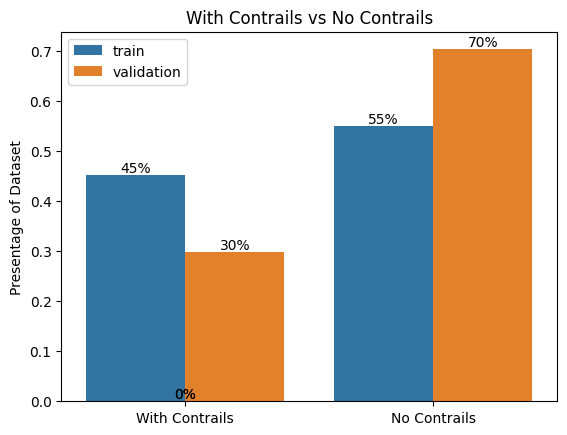

In [9]:
train_with_contrails = train_images_with_contrails / (train_images_with_contrails + train_images_without_contrails)
train_without_contrails = train_images_without_contrails / (train_images_with_contrails + train_images_without_contrails)
validation_with_contrails = validation_images_with_contrails / (validation_images_with_contrails + validation_images_without_contrails)
validation_without_contrails = validation_images_without_contrails / (validation_images_with_contrails + validation_images_without_contrails)
data = pd.DataFrame({'Type': ['With Contrails', 'No Contrails', 'With Contrails', 'No Contrails'],
        'Data': [train_with_contrails, train_without_contrails, validation_with_contrails, validation_without_contrails],
        'Data Set': ['train', 'train', 'validation', 'validation']})

ax = sns.barplot(data=data, y='Data', x="Type", hue="Data Set", orient='v')

for p in ax.patches:
    ax.annotate(format(p.get_height() * 100, '.0f') + '%',
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha = 'center', va = 'center',
                xytext = (0, 5),
                textcoords = 'offset points')
    
ax.set_xlabel('')
ax.set_ylabel('Presentage of Dataset')
ax.set_title('With Contrails vs No Contrails')

plt.legend()
plt.show()

There is a significantly higher percentage of images with contrails in the train dataset than in the validation.

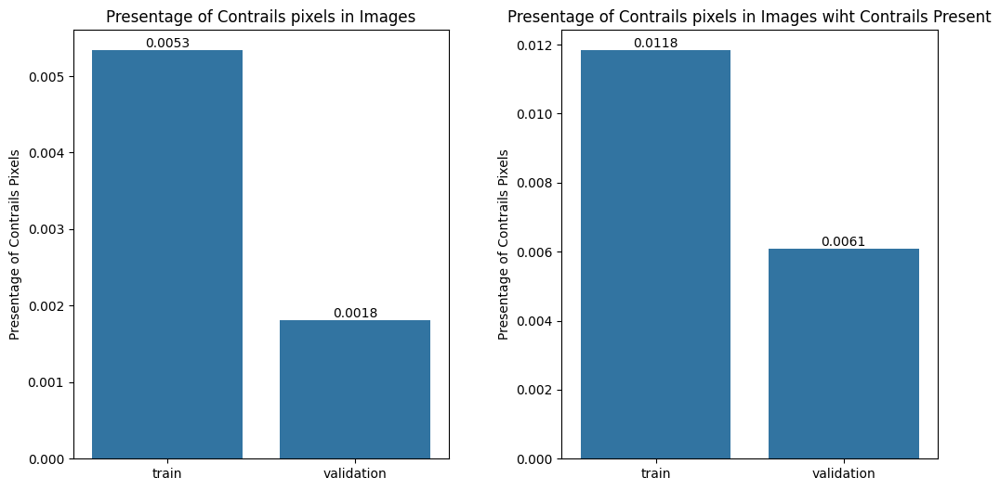

In [10]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 6))
fig.subplots_adjust(wspace=0.3)
axes = axes.flatten()

train_with_contrails_pix = train_contrail_pixel_count / (train_contrail_pixel_count + train_non_contrail_pixel_count)
validation_with_contrails_pix = validation_contrail_pixel_count / (validation_contrail_pixel_count + validation_non_contrail_pixel_count)
data = pd.DataFrame({'Data': [train_with_contrails_pix, validation_with_contrails_pix],
        'Data Set': ['train', 'validation']})
sns.barplot(data=data, y='Data', x="Data Set", orient='v', ax=axes[0])
for p in axes[0].patches:
    axes[0].annotate(format(p.get_height(), '.4f'),
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha = 'center', va = 'center',
                xytext = (0, 5),
                textcoords = 'offset points')
axes[0].set_xlabel('')
axes[0].set_ylabel('Presentage of Contrails Pixels')
axes[0].set_title('Presentage of Contrails pixels in Images')

train_with_contrails_pix_conly = train_contrail_pixel_count_conly / (train_contrail_pixel_count_conly + train_non_contrail_pixel_count_conly)
validation_with_contrails_pix_conly = validation_contrail_pixel_count_conly / (validation_contrail_pixel_count_conly + validation_non_contrail_pixel_count_conly)
data = pd.DataFrame({'Data': [train_with_contrails_pix_conly, validation_with_contrails_pix_conly],
        'Data Set': ['train', 'validation']})
sns.barplot(data=data, y='Data', x="Data Set", orient='v', ax=axes[1])
for p in axes[1].patches:
    axes[1].annotate(format(p.get_height(), '.4f'),
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha = 'center', va = 'center',
                xytext = (0, 5),
                textcoords = 'offset points')
axes[1].set_xlabel('')
axes[1].set_ylabel('Presentage of Contrails Pixels')
axes[1].set_title('Presentage of Contrails pixels in Images wiht Contrails Present')

plt.show()

There is a significant imbalance in the number of pixels between the negative class (non-contrail) and the positive class (contrail). In the training and validation datasets, the ratio of negative to positive class pixels is 85:1 and 164:1 respectively. This severe class imbalance can lead to biased models that prioritize the majority class, ultimately reducing the overall prediction quality.

To address this issue, we can employ two strategies: optimizing the confidence threshold during post-processing or incorporating class weights into the loss function during training.

Optimizing confidence threshold during post-processing:
After training the model, we can adjust the confidence threshold used to determine class predictions. By carefully selecting the threshold, we can increase the sensitivity to the positive class, thereby improving the detection of contrails. This approach allows us to fine-tune the model's predictions without retraining it.

Adding class weights to the loss function during training:
Another way to handle the class imbalance is by assigning appropriate weights to the different classes during model training. By assigning higher weights to the minority class (contrail), we can increase its influence on the loss function. This adjustment ensures that the model pays more attention to the positive class and helps mitigate the bias towards the majority class (non-contrail).

This notebook will utilize both strategies.

Additionally, I thought it was worth pointing out that there are significantly lass contrails in the validation images than in the train images.

In [11]:
def show_band_images(idx: str, parrent_folder: str, band: str):
    data = get_band_images(idx, parrent_folder, band)
    fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(20, 10))
    axes = axes.flatten()
    for i in range(8):
        axes[i].imshow(data[:,:,i])
        axes[i].axis('off')
    plt.show()

def show_ash_images(idx: str, parrent_folder: str):
    data = get_ash_color_images(idx, parrent_folder)
    fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(20, 10))
    axes = axes.flatten()
    for i in range(8):
        axes[i].imshow(data[:,:,:,i])
        axes[i].axis('off')
    plt.show()

def show_ash_frame(idx: str, parrent_folder: str, frame: int):
    data = get_ash_color_images(idx, parrent_folder)
    plt.imshow(data[:,:,:,frame])
    plt.show()
    
def show_mask_image(idx: str, parrent_folder: str):
    plt.imshow(get_mask_image(idx, parrent_folder))
    plt.show()

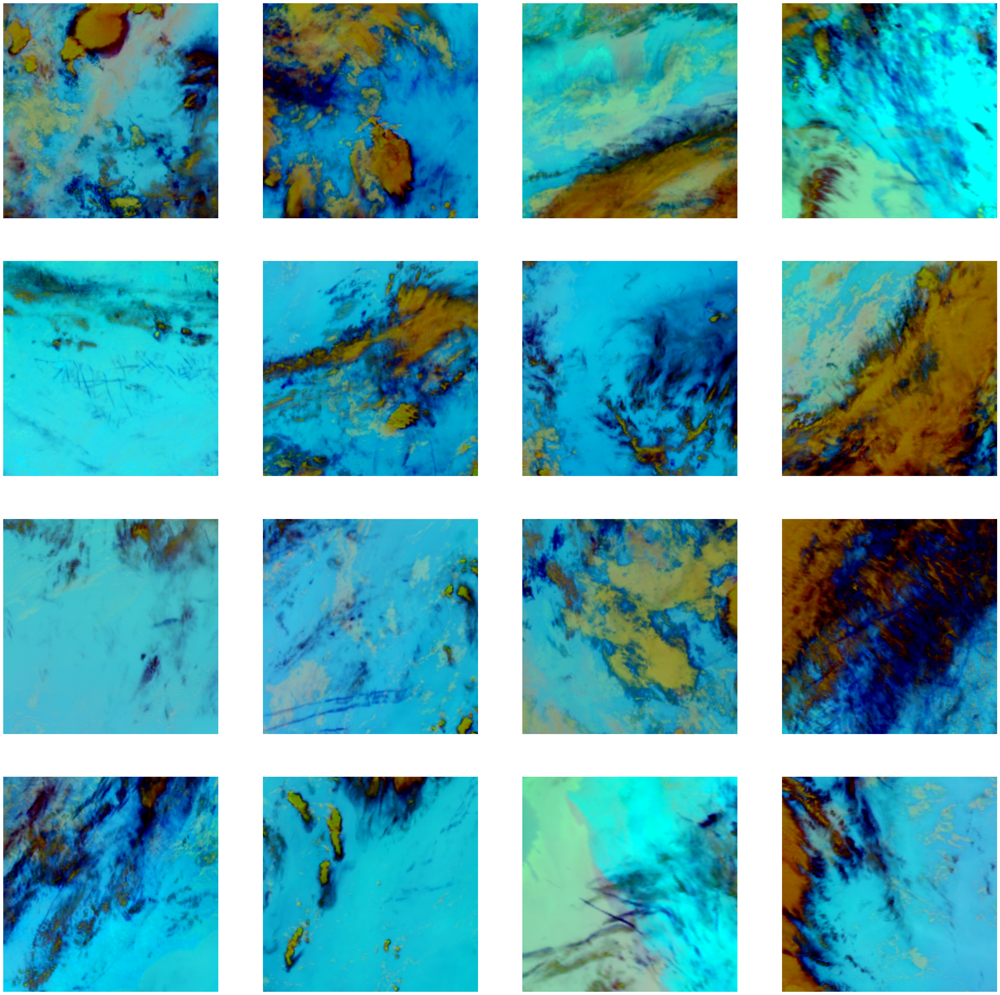

In [12]:
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(40, 40))
axes = axes.flatten()

for i in range(len(axes)):
    images = get_ash_color_images(str(df_train_idx.iloc[730 + i]['idx']), 'train')
    axes[i].imshow(images[:,:,:,4])
    axes[i].axis('off')

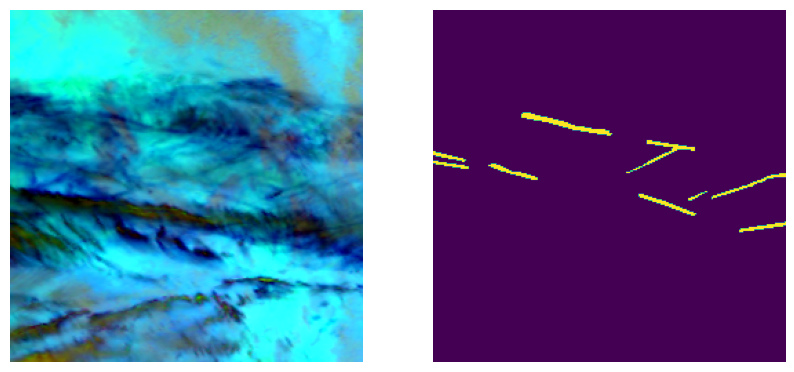

In [13]:
images = get_ash_color_images(str(df_train_idx.iloc[683]['idx']), 'train')
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))
axes = axes.flatten()

axes[0].imshow(images[:,:,:,4])
axes[0].axis('off')
axes[1].imshow(get_mask_image(str(df_train_idx.iloc[683]['idx']), 'train'))
axes[1].axis('off')

plt.show()

In [ ]:
false_color = get_ash_color_images(str(df_train_idx.iloc[683]['idx']), 'train')
# Animation
fig, ax = plt.subplots(figsize=(6, 6))
ax.set_axis_off()
im = plt.imshow(false_color[..., 0])
def draw(i):
    im.set_array(false_color[..., i])
    return [im]
anim = animation.FuncAnimation(
    fig, draw, frames=false_color.shape[-1], interval=500, blit=True
)
plt.close()
display.HTML(anim.to_jshtml())

# Model

In [14]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

In [15]:
import torch
import torch.nn as nn
import torch.nn.functional as F

# CBAM Modules
class ChannelAttention(nn.Module):
    def __init__(self, in_planes, ratio=16):
        super(ChannelAttention, self).__init__()
        self.fc1 = nn.Conv2d(in_planes, in_planes // ratio, kernel_size=1, bias=False)
        self.relu = nn.ReLU()
        self.fc2 = nn.Conv2d(in_planes // ratio, in_planes, kernel_size=1, bias=False)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        # Use dim=2 and dim=3 separately for torch.mean and torch.max
        avg_out = torch.mean(x, dim=(2, 3), keepdim=True)
        max_out, _ = torch.max(x, dim=2, keepdim=True)
        max_out, _ = torch.max(max_out, dim=3, keepdim=True)
        out = self.fc1(avg_out) + self.fc1(max_out)
        out = self.relu(out)
        out = self.fc2(out)
        return self.sigmoid(out) * x


class SpatialAttention(nn.Module):
    def __init__(self, kernel_size=7):
        super(SpatialAttention, self).__init__()
        self.conv = nn.Conv2d(2, 1, kernel_size=kernel_size, padding=kernel_size // 2, bias=False)

    def forward(self, x):
        avg_out = torch.mean(x, dim=1, keepdim=True)
        max_out, _ = torch.max(x, dim=1, keepdim=True)
        out = torch.cat([avg_out, max_out], dim=1)
        out = self.conv(out)
        return torch.sigmoid(out) * x

class CBAM(nn.Module):
    def __init__(self, in_channels, reduction=16, kernel_size=7):
        super(CBAM, self).__init__()
        self.channel_attention = ChannelAttention(in_channels, reduction)
        self.spatial_attention = SpatialAttention(kernel_size)

    def forward(self, x):
        x = self.channel_attention(x)
        x = self.spatial_attention(x)
        return x

# DoubleConv with CBAM Integrated
class DoubleConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(DoubleConv, self).__init__()
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )
        self.cbam = CBAM(out_channels)

    def forward(self, x):
        x = self.double_conv(x)
        x = self.cbam(x)
        return x

# Down (Encoder Block)
class Down(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(Down, self).__init__()
        self.maxpool_conv = nn.Sequential(
            nn.MaxPool2d(2),
            DoubleConv(in_channels, out_channels)
        )

    def forward(self, x):
        return self.maxpool_conv(x)

# Up (Decoder Block)
class Up(nn.Module):
    def __init__(self, in_channels, out_channels, bilinear=True):
        super(Up, self).__init__()

        if bilinear:
            self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        else:
            self.up = nn.ConvTranspose2d(in_channels // 2, in_channels // 2, kernel_size=2, stride=2)

        self.conv = DoubleConv(in_channels, out_channels)

    def forward(self, x1, x2):
        x1 = self.up(x1)

        diffY = x2.size()[2] - x1.size()[2]
        diffX = x2.size()[3] - x1.size()[3]

        x1 = nn.functional.pad(x1, [diffX // 2, diffX - diffX // 2, diffY // 2, diffY - diffY // 2])
        
        x = torch.cat([x2, x1], dim=1)
        return self.conv(x)

# UNet with CBAM
class UNet(nn.Module):
    def __init__(self):
        super(UNet, self).__init__()
        self.inc = DoubleConv(24, 64)
        self.down1 = Down(64, 128)
        self.down2 = Down(128, 256)
        self.down3 = Down(256, 512)
        self.down4 = Down(512, 512)
        self.up1 = Up(1024, 256)
        self.up2 = Up(512, 128)
        self.up3 = Up(256, 64)
        self.up4 = Up(128, 64)
        self.outc = nn.Conv2d(64, 1, kernel_size=1)

    def forward(self, x):
        x1 = self.inc(x)
        x2 = self.down1(x1)
        x3 = self.down2(x2)
        x4 = self.down3(x3)
        x5 = self.down4(x4)
        x = self.up1(x5, x4)
        x = self.up2(x, x3)
        x = self.up3(x, x2)
        x = self.up4(x, x1)
        x = self.outc(x)
        return x


In [16]:
summary(UNet().to(device), input_size=(24, 256, 256))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 256, 256]          13,888
       BatchNorm2d-2         [-1, 64, 256, 256]             128
              ReLU-3         [-1, 64, 256, 256]               0
            Conv2d-4         [-1, 64, 256, 256]          36,928
       BatchNorm2d-5         [-1, 64, 256, 256]             128
              ReLU-6         [-1, 64, 256, 256]               0
            Conv2d-7              [-1, 4, 1, 1]             256
            Conv2d-8              [-1, 4, 1, 1]             256
              ReLU-9              [-1, 4, 1, 1]               0
           Conv2d-10             [-1, 64, 1, 1]             256
          Sigmoid-11             [-1, 64, 1, 1]               0
 ChannelAttention-12         [-1, 64, 256, 256]               0
           Conv2d-13          [-1, 1, 256, 256]              98
 SpatialAttention-14         [-1, 64, 2

# Trainer

In [17]:
class Dice(nn.Module):
    def __init__(self, use_sigmoid=True):
        super(Dice, self).__init__()
        self.sigmoid = nn.Sigmoid()
        self.use_sigmoid = use_sigmoid

    def forward(self, inputs, targets, smooth=1):
        if self.use_sigmoid:
            inputs = self.sigmoid(inputs)       
        
        inputs = inputs.view(-1)
        targets = targets.view(-1)
        
        intersection = (inputs * targets).sum()
        dice = (2.0 *intersection + smooth)/(inputs.sum() + targets.sum() + smooth)  
        
        return dice
    
dice = Dice()

In [18]:
# Custom combined BCE + Dice Loss function
def combined_bce_dice_loss(pred, target, pos_weight=100):
    """Calculates BCEWithLogitsLoss + Dice Loss."""
    # Binary Cross-Entropy Loss
    bce_loss = nn.BCEWithLogitsLoss(pos_weight=torch.tensor(pos_weight))(pred, target)
    
    # Dice Loss calculation
    pred_probs = torch.sigmoid(pred)  # Apply sigmoid to convert logits to probabilities
    smooth = 1e-6  # To avoid division by zero
    intersection = (pred_probs * target).sum(dim=(1, 2, 3))  # Sum over spatial dimensions
    dice_loss = 1 - (2. * intersection + smooth) / (pred_probs.sum(dim=(1, 2, 3)) + target.sum(dim=(1, 2, 3)) + smooth)
    dice_loss = dice_loss.mean()  # Take mean over batch
    
    # Combine BCE and Dice Loss
    total_loss = bce_loss + dice_loss
    return total_loss

In [19]:
# class MyTrainer:
#     def __init__(self, model, optimizer, loss_fn, lr_scheduler):
#         self.validation_losses = []
#         self.batch_losses = []
#         self.epoch_losses = []
#         self.learning_rates = []
#         self.model = model
#         self.optimizer = optimizer
#         self.loss_fn = loss_fn
#         self.lr_scheduler = lr_scheduler
#         self._check_optim_net_aligned()

#     # Ensures that the given optimizer points to the given model
#     def _check_optim_net_aligned(self):
#         assert self.optimizer.param_groups[0]['params'] == list(self.model.parameters())

#     # Trains the model
#     def fit(self,
#             train_dataloader: DataLoader,
#             test_dataloader: DataLoader,
#             epochs: int = 10,
#             eval_every: int = 1,
#             ):
  
#         for e in range(epochs):
#             print("New learning rate: {}".format(self.lr_scheduler.get_last_lr()))
#             self.learning_rates.append(self.lr_scheduler.get_last_lr()[0])

#             # Stores data about the batch
#             batch_losses = []
#             sub_batch_losses = []

#             for i, data in enumerate(train_dataloader):
#                 self.model.train()
#                 if i % 100 == 0:
#                     print(f'epotch: {e} batch: {i}/{len(train_dataloader)} loss: {torch.Tensor(sub_batch_losses).mean()}')
#                     sub_batch_losses.clear()
#                 # Every data instance is an input + label pair
#                 images, mask = data
                
#                 if torch.cuda.is_available():
#                     images = images.cuda()
#                     mask = mask.cuda()

#                 # Zero your gradients for every batch!
#                 self.optimizer.zero_grad()
#                 # Make predictions for this batch
#                 outputs = self.model(images)
#                 # Compute the loss and its gradients
#                 loss = self.loss_fn(outputs, mask)
#                 loss.backward()
#                 # Adjust learning weights
#                 self.optimizer.step()

#                 # Saves data
#                 self.batch_losses.app end(loss.item())
#                 batch_losses.append(loss)
#                 sub_batch_losses.append(loss)

#             # Adjusts learning rate
#             if self.lr_scheduler is not None:
#                 self.lr_scheduler.step()

#             # Reports on the path
#             mean_epoch_loss = torch.Tensor(batch_losses).mean()
#             self.epoch_losses.append(mean_epoch_loss.item())
#             print('Train Epoch: {} Average Loss: {:.6f}'.format(e, mean_epoch_loss))

#             # Reports on the training progress
#             if (e + 1) % eval_every == 0:
#                 torch.save(self.model.state_dict(), "model_checkpoint_e" + str(e) + ".pt")
#                 with torch.no_grad():
#                     self.model.eval()
#                     losses = []
#                     for i, data in enumerate(test_dataloader):
#                         # Every data instance is an input + label pair
#                         images, mask = data

#                         if torch.cuda.is_available():
#                             images = images.cuda()
#                             mask = mask.cuda()

#                         output = self.model(images)
#                         loss = self.loss_fn(output, mask)
#                         losses.append(loss.item())
                        
#                     avg_loss = torch.Tensor(losses).mean().item()
#                     self.validation_losses.append(avg_loss)
#                     print("Validation loss after", (e + 1), "epochs was", round(avg_loss, 4))

In [20]:
# Trainer with BCE + Dice Loss 
from tqdm import tqdm  # Import tqdm for the progress bar

class MyTrainer:
    def __init__(self, model, optimizer, loss_fn, lr_scheduler):
        self.validation_losses = []
        self.batch_losses = []
        self.epoch_losses = []
        self.learning_rates = []
        self.model = model
        self.optimizer = optimizer
        # self.loss_fn = loss_fn
        self.lr_scheduler = lr_scheduler
        self._check_optim_net_aligned()

    # Ensures that the given optimizer points to the given model
    def _check_optim_net_aligned(self):
        assert self.optimizer.param_groups[0]['params'] == list(self.model.parameters())

    # Trains the model
    def fit(self,
            train_dataloader: DataLoader,
            test_dataloader: DataLoader,
            epochs: int = 10,
            eval_every: int = 1,
            ):  
        for e in range(epochs):
            print("New learning rate: {}".format(self.lr_scheduler.get_last_lr()))
            self.learning_rates.append(self.lr_scheduler.get_last_lr()[0])

            # Stores data about the batch
            batch_losses = []
            sub_batch_losses = []

            # Progress bar for batches
            with tqdm(total=len(train_dataloader), desc=f"Epoch {e+1}/{epochs}", unit="batch") as pbar:
                for i, data in enumerate(train_dataloader):
                    self.model.train()
                    
                    # Update progress bar with the current batch
                    pbar.update(1)
                    pbar.set_postfix(loss=torch.Tensor(sub_batch_losses).mean().item() if sub_batch_losses else 0.0)
                    
                    if i % 100 == 0:
                        print(f'Epoch: {e} Batch: {i}/{len(train_dataloader)} Loss: {torch.Tensor(sub_batch_losses).mean()}')
                        sub_batch_losses.clear()
                    
                    # Every data instance is an input + label pair
                    images, mask = data
                    
                    if torch.cuda.is_available():
                        images = images.cuda()
                        mask = mask.cuda()

                    # Zero your gradients for every batch!
                    self.optimizer.zero_grad()
                    
                    # Make predictions for this batch
                    outputs = self.model(images)
                    
                    # Compute the loss and its gradients
                    # loss = self.loss_fn(outputs, mask)
                    loss = combined_bce_dice_loss(outputs, mask, pos_weight=100)
                    loss.backward()
                    
                    # Adjust learning weights
                    self.optimizer.step()

                    # Saves data
                    self.batch_losses.append(loss.item())
                    batch_losses.append(loss)
                    sub_batch_losses.append(loss)

            # Adjusts learning rate
            if self.lr_scheduler is not None:
                self.lr_scheduler.step()

            # Reports on the path
            mean_epoch_loss = torch.Tensor(batch_losses).mean()
            self.epoch_losses.append(mean_epoch_loss.item())
            print('Train Epoch: {} Average Loss: {:.6f}'.format(e, mean_epoch_loss))

            # Reports on the training progress
            if (e + 1) % eval_every == 0:
                torch.save(self.model.state_dict(), "checkpoints/" + type(self.model).__name__ + "_model_checkpoint_e" + str(e) + ".pt")
                with torch.no_grad():
                    self.model.eval()
                    losses = []
                    for i, data in enumerate(test_dataloader):
                        # Every data instance is an input + label pair
                        images, mask = data

                        if torch.cuda.is_available():
                            images = images.cuda()
                            mask = mask.cuda()

                        output = self.model(images)
                        # loss = self.loss_fn(output, mask)
                        loss = combined_bce_dice_loss(output, mask, pos_weight=100)
                        losses.append(loss.item())
                        
                    avg_loss = torch.Tensor(losses).mean().item()
                    self.validation_losses.append(avg_loss)
                    print("Validation loss after", (e + 1), "epochs was", round(avg_loss, 4))


# Dataset

In [21]:
class ContrailsAshDataset(torch.utils.data.Dataset):
    def __init__(self, parrent_folder: str):
        self.df_idx: pd.DataFrame = pd.DataFrame({'idx': os.listdir(f'/media/jychpr/ADATA SD810/kaggle_data/google-research-identify-contrails-reduce-global-warming/{parrent_folder}')})
        self.parrent_folder: str = parrent_folder

    def __len__(self):
        return len(self.df_idx)

    def __getitem__(self, idx):
        image_id: str = str(self.df_idx.iloc[idx]['idx'])
        images = torch.tensor(np.reshape(get_ash_color_images(image_id, self.parrent_folder, get_mask_frame_only=False), (256, 256, 24))).to(torch.float32).permute(2, 0, 1)
        mask = torch.tensor(get_mask_image(image_id, self.parrent_folder)).to(torch.float32).permute(2, 0, 1)
        return images, mask

In [22]:
dataset_train = ContrailsAshDataset('train')
dataset_validation = ContrailsAshDataset('validation')

data_loader_train = DataLoader(dataset_train, batch_size=16, shuffle=True, num_workers=2)
data_loader_validation = DataLoader(dataset_validation, batch_size=16, shuffle=True, num_workers=2)

# Train

In [23]:
train = True

In [24]:
if train:
    model = UNet()  # Pastikan UNet dengan CBAM digunakan
    model.to(device)

    criterion = nn.BCEWithLogitsLoss(pos_weight=torch.tensor(100).to(device))
    optimizer = optim.Adam(model.parameters(), lr=0.001)  # Gunakan learning rate default dulu
    lr_scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.9)

    num_epochs = 12

    trainer = MyTrainer(model, optimizer, criterion, lr_scheduler)
    trainer.fit(data_loader_train, data_loader_validation, epochs=num_epochs)

else:
    model = UNet()
    model.load_state_dict(torch.load('/kaggle/input/contrails-unet-pretrained/unet.pt'))
    model.eval()
    model.to(device)

New learning rate: [0.001]


Epoch 1/12:   0%|                   | 1/1284 [00:00<07:43,  2.77batch/s, loss=0]

Epoch: 0 Batch: 0/1284 Loss: nan


Epoch 1/12:   8%|█             | 101/1284 [00:26<05:10,  3.81batch/s, loss=1.76]

Epoch: 0 Batch: 100/1284 Loss: 1.7605395317077637


Epoch 1/12:  16%|██▏           | 201/1284 [00:53<04:49,  3.74batch/s, loss=1.54]

Epoch: 0 Batch: 200/1284 Loss: 1.5356383323669434


Epoch 1/12:  23%|███▎          | 301/1284 [01:19<04:20,  3.77batch/s, loss=1.48]

Epoch: 0 Batch: 300/1284 Loss: 1.4846497774124146


Epoch 1/12:  31%|████▎         | 401/1284 [01:46<03:54,  3.76batch/s, loss=1.47]

Epoch: 0 Batch: 400/1284 Loss: 1.468446969985962


Epoch 1/12:  39%|█████▍        | 501/1284 [02:12<03:30,  3.73batch/s, loss=1.46]

Epoch: 0 Batch: 500/1284 Loss: 1.4621418714523315


Epoch 1/12:  47%|██████▌       | 601/1284 [02:39<03:02,  3.75batch/s, loss=1.43]

Epoch: 0 Batch: 600/1284 Loss: 1.4320582151412964


Epoch 1/12:  55%|███████▋      | 701/1284 [03:06<02:35,  3.75batch/s, loss=1.43]

Epoch: 0 Batch: 700/1284 Loss: 1.4301739931106567


Epoch 1/12:  62%|████████▋     | 801/1284 [03:32<02:08,  3.75batch/s, loss=1.38]

Epoch: 0 Batch: 800/1284 Loss: 1.3835033178329468


Epoch 1/12:  70%|██████████▌    | 901/1284 [03:59<01:42,  3.74batch/s, loss=1.4]

Epoch: 0 Batch: 900/1284 Loss: 1.3969542980194092


Epoch 1/12:  78%|██████████▏  | 1001/1284 [04:26<01:15,  3.73batch/s, loss=1.35]

Epoch: 0 Batch: 1000/1284 Loss: 1.3544093370437622


Epoch 1/12:  86%|███████████▏ | 1101/1284 [04:53<00:49,  3.72batch/s, loss=1.39]

Epoch: 0 Batch: 1100/1284 Loss: 1.3897061347961426


Epoch 1/12:  94%|████████████▏| 1201/1284 [05:19<00:22,  3.74batch/s, loss=1.32]

Epoch: 0 Batch: 1200/1284 Loss: 1.3245915174484253


Epoch 1/12: 100%|█████████████| 1284/1284 [05:42<00:00,  3.75batch/s, loss=1.32]


Train Epoch: 0 Average Loss: 1.442950
Validation loss after 1 epochs was 1.202
New learning rate: [0.0009000000000000001]


Epoch 2/12:   0%|                   | 1/1284 [00:00<08:33,  2.50batch/s, loss=0]

Epoch: 1 Batch: 0/1284 Loss: nan


Epoch 2/12:   8%|█             | 101/1284 [00:26<05:13,  3.78batch/s, loss=1.31]

Epoch: 1 Batch: 100/1284 Loss: 1.3094819784164429


Epoch 2/12:  16%|██▏           | 201/1284 [00:53<04:47,  3.76batch/s, loss=1.28]

Epoch: 1 Batch: 200/1284 Loss: 1.2777937650680542


Epoch 2/12:  23%|███▎          | 301/1284 [01:20<04:22,  3.75batch/s, loss=1.29]

Epoch: 1 Batch: 300/1284 Loss: 1.2945168018341064


Epoch 2/12:  31%|████▎         | 401/1284 [01:46<03:54,  3.76batch/s, loss=1.26]

Epoch: 1 Batch: 400/1284 Loss: 1.2615400552749634


Epoch 2/12:  39%|█████▍        | 501/1284 [02:13<03:30,  3.72batch/s, loss=1.26]

Epoch: 1 Batch: 500/1284 Loss: 1.258427381515503


Epoch 2/12:  47%|██████▌       | 601/1284 [02:40<03:03,  3.73batch/s, loss=1.25]

Epoch: 1 Batch: 600/1284 Loss: 1.2538059949874878


Epoch 2/12:  55%|███████▋      | 701/1284 [03:07<02:39,  3.66batch/s, loss=1.24]

Epoch: 1 Batch: 700/1284 Loss: 1.2445160150527954


Epoch 2/12:  62%|████████▋     | 801/1284 [03:34<02:09,  3.72batch/s, loss=1.21]

Epoch: 1 Batch: 800/1284 Loss: 1.2103086709976196


Epoch 2/12:  70%|█████████▊    | 901/1284 [04:01<01:43,  3.71batch/s, loss=1.21]

Epoch: 1 Batch: 900/1284 Loss: 1.2074432373046875


Epoch 2/12:  78%|██████████▉   | 1001/1284 [04:27<01:16,  3.72batch/s, loss=1.2]

Epoch: 1 Batch: 1000/1284 Loss: 1.2019068002700806


Epoch 2/12:  86%|███████████▏ | 1101/1284 [04:54<00:49,  3.73batch/s, loss=1.19]

Epoch: 1 Batch: 1100/1284 Loss: 1.191723346710205


Epoch 2/12:  94%|████████████▏| 1201/1284 [05:21<00:22,  3.73batch/s, loss=1.21]

Epoch: 1 Batch: 1200/1284 Loss: 1.205315113067627


Epoch 2/12: 100%|█████████████| 1284/1284 [05:43<00:00,  3.73batch/s, loss=1.19]

Train Epoch: 1 Average Loss: 1.239236


Validation loss after 2 epochs was 1.1339
New learning rate: [0.0008100000000000001]


Epoch 3/12:   0%|                   | 1/1284 [00:00<09:11,  2.33batch/s, loss=0]

Epoch: 2 Batch: 0/1284 Loss: nan


Epoch 3/12:   8%|█             | 101/1284 [00:27<05:17,  3.73batch/s, loss=1.19]

Epoch: 2 Batch: 100/1284 Loss: 1.1852655410766602


Epoch 3/12:  16%|██▏           | 201/1284 [00:53<04:46,  3.78batch/s, loss=1.16]

Epoch: 2 Batch: 200/1284 Loss: 1.1563901901245117


Epoch 3/12:  23%|███▎          | 301/1284 [01:20<04:22,  3.74batch/s, loss=1.15]

Epoch: 2 Batch: 300/1284 Loss: 1.1497695446014404


Epoch 3/12:  31%|████▎         | 401/1284 [01:47<03:55,  3.75batch/s, loss=1.14]

Epoch: 2 Batch: 400/1284 Loss: 1.1362806558609009


Epoch 3/12:  39%|█████▍        | 501/1284 [02:13<03:29,  3.75batch/s, loss=1.15]

Epoch: 2 Batch: 500/1284 Loss: 1.1485894918441772


Epoch 3/12:  47%|██████▌       | 601/1284 [02:40<03:03,  3.72batch/s, loss=1.14]

Epoch: 2 Batch: 600/1284 Loss: 1.1392898559570312


Epoch 3/12:  55%|███████▋      | 701/1284 [03:07<02:35,  3.75batch/s, loss=1.14]

Epoch: 2 Batch: 700/1284 Loss: 1.1375802755355835


Epoch 3/12:  62%|████████▋     | 801/1284 [03:34<02:09,  3.73batch/s, loss=1.14]

Epoch: 2 Batch: 800/1284 Loss: 1.1444907188415527


Epoch 3/12:  70%|█████████▊    | 901/1284 [04:00<01:42,  3.75batch/s, loss=1.14]

Epoch: 2 Batch: 900/1284 Loss: 1.1440532207489014


Epoch 3/12:  78%|██████████▏  | 1001/1284 [04:27<01:15,  3.74batch/s, loss=1.14]

Epoch: 2 Batch: 1000/1284 Loss: 1.14017915725708


Epoch 3/12:  86%|███████████▏ | 1101/1284 [04:54<00:48,  3.74batch/s, loss=1.14]

Epoch: 2 Batch: 1100/1284 Loss: 1.142488718032837


Epoch 3/12:  94%|████████████▏| 1201/1284 [05:20<00:22,  3.77batch/s, loss=1.13]

Epoch: 2 Batch: 1200/1284 Loss: 1.131543517112732


Epoch 3/12: 100%|█████████████| 1284/1284 [05:42<00:00,  3.74batch/s, loss=1.13]

Train Epoch: 2 Average Loss: 1.148060


Validation loss after 3 epochs was 1.1027
New learning rate: [0.000729]


Epoch 4/12:   0%|                   | 1/1284 [00:00<09:07,  2.34batch/s, loss=0]

Epoch: 3 Batch: 0/1284 Loss: nan


Epoch 4/12:   8%|█             | 101/1284 [00:27<05:15,  3.75batch/s, loss=1.17]

Epoch: 3 Batch: 100/1284 Loss: 1.165776014328003


Epoch 4/12:  16%|██▏           | 201/1284 [00:53<04:49,  3.74batch/s, loss=1.12]

Epoch: 3 Batch: 200/1284 Loss: 1.1191972494125366


Epoch 4/12:  23%|███▎          | 301/1284 [01:20<04:24,  3.72batch/s, loss=1.09]

Epoch: 3 Batch: 300/1284 Loss: 1.0931391716003418


Epoch 4/12:  31%|████▎         | 401/1284 [01:47<03:57,  3.72batch/s, loss=1.11]

Epoch: 3 Batch: 400/1284 Loss: 1.1143290996551514


Epoch 4/12:  39%|█████▍        | 501/1284 [02:13<03:28,  3.76batch/s, loss=1.12]

Epoch: 3 Batch: 500/1284 Loss: 1.1163055896759033


Epoch 4/12:  47%|██████▌       | 601/1284 [02:40<03:02,  3.75batch/s, loss=1.12]

Epoch: 3 Batch: 600/1284 Loss: 1.1181652545928955


Epoch 4/12:  55%|████████▏      | 701/1284 [03:07<02:35,  3.76batch/s, loss=1.1]

Epoch: 3 Batch: 700/1284 Loss: 1.1026592254638672


Epoch 4/12:  62%|████████▋     | 801/1284 [03:33<02:09,  3.74batch/s, loss=1.08]

Epoch: 3 Batch: 800/1284 Loss: 1.0842061042785645


Epoch 4/12:  70%|██████████▌    | 901/1284 [04:00<01:42,  3.75batch/s, loss=1.1]

Epoch: 3 Batch: 900/1284 Loss: 1.0992809534072876


Epoch 4/12:  78%|██████████▉   | 1001/1284 [04:27<01:15,  3.73batch/s, loss=1.1]

Epoch: 3 Batch: 1000/1284 Loss: 1.0956732034683228


Epoch 4/12:  86%|████████████  | 1101/1284 [04:53<00:48,  3.74batch/s, loss=1.1]

Epoch: 3 Batch: 1100/1284 Loss: 1.1019541025161743


Epoch 4/12:  94%|████████████▏| 1201/1284 [05:20<00:22,  3.74batch/s, loss=1.08]

Epoch: 3 Batch: 1200/1284 Loss: 1.0830713510513306


Epoch 4/12: 100%|█████████████| 1284/1284 [05:42<00:00,  3.74batch/s, loss=1.09]

Train Epoch: 3 Average Loss: 1.107738


Validation loss after 4 epochs was 1.1214
New learning rate: [0.0006561000000000001]


Epoch 5/12:   0%|                   | 1/1284 [00:00<08:15,  2.59batch/s, loss=0]

Epoch: 4 Batch: 0/1284 Loss: nan


Epoch 5/12:   8%|█             | 101/1284 [00:27<05:16,  3.74batch/s, loss=1.12]

Epoch: 4 Batch: 100/1284 Loss: 1.1192283630371094


Epoch 5/12:  16%|██▏           | 201/1284 [00:53<04:48,  3.75batch/s, loss=1.09]

Epoch: 4 Batch: 200/1284 Loss: 1.0856308937072754


Epoch 5/12:  23%|███▎          | 301/1284 [01:20<04:22,  3.74batch/s, loss=1.08]

Epoch: 4 Batch: 300/1284 Loss: 1.0759382247924805


Epoch 5/12:  31%|████▎         | 401/1284 [01:47<03:56,  3.73batch/s, loss=1.07]

Epoch: 4 Batch: 400/1284 Loss: 1.06850004196167


Epoch 5/12:  39%|█████▍        | 501/1284 [02:13<03:28,  3.76batch/s, loss=1.07]

Epoch: 4 Batch: 500/1284 Loss: 1.0749917030334473


Epoch 5/12:  47%|██████▌       | 601/1284 [02:40<03:01,  3.76batch/s, loss=1.06]

Epoch: 4 Batch: 600/1284 Loss: 1.0646723508834839


Epoch 5/12:  55%|███████▋      | 701/1284 [03:06<02:35,  3.74batch/s, loss=1.07]

Epoch: 4 Batch: 700/1284 Loss: 1.0729011297225952


Epoch 5/12:  62%|████████▋     | 801/1284 [03:33<02:08,  3.77batch/s, loss=1.08]

Epoch: 4 Batch: 800/1284 Loss: 1.0755877494812012


Epoch 5/12:  70%|█████████▊    | 901/1284 [04:00<01:42,  3.75batch/s, loss=1.06]

Epoch: 4 Batch: 900/1284 Loss: 1.063438892364502


Epoch 5/12:  78%|██████████▏  | 1001/1284 [04:26<01:15,  3.73batch/s, loss=1.07]

Epoch: 4 Batch: 1000/1284 Loss: 1.0738754272460938


Epoch 5/12:  86%|███████████▏ | 1101/1284 [04:53<00:48,  3.75batch/s, loss=1.08]

Epoch: 4 Batch: 1100/1284 Loss: 1.0816293954849243


Epoch 5/12:  94%|████████████▏| 1201/1284 [05:20<00:22,  3.75batch/s, loss=1.07]

Epoch: 4 Batch: 1200/1284 Loss: 1.0741596221923828


Epoch 5/12: 100%|█████████████| 1284/1284 [05:42<00:00,  3.75batch/s, loss=1.05]

Train Epoch: 4 Average Loss: 1.089331


Validation loss after 5 epochs was 1.0968
New learning rate: [0.00059049]


Epoch 6/12:   0%|                   | 1/1284 [00:00<07:56,  2.69batch/s, loss=0]

Epoch: 5 Batch: 0/1284 Loss: nan


Epoch 6/12:   8%|█             | 101/1284 [00:26<05:16,  3.73batch/s, loss=1.26]

Epoch: 5 Batch: 100/1284 Loss: 1.2552410364151


Epoch 6/12:  16%|██▏           | 201/1284 [00:53<04:49,  3.75batch/s, loss=1.11]

Epoch: 5 Batch: 200/1284 Loss: 1.1128170490264893


Epoch 6/12:  23%|███▎          | 301/1284 [01:20<04:21,  3.76batch/s, loss=1.09]

Epoch: 5 Batch: 300/1284 Loss: 1.0923070907592773


Epoch 6/12:  31%|████▎         | 401/1284 [01:47<03:55,  3.75batch/s, loss=1.09]

Epoch: 5 Batch: 400/1284 Loss: 1.0893261432647705


Epoch 6/12:  39%|█████▍        | 501/1284 [02:13<03:29,  3.74batch/s, loss=1.08]

Epoch: 5 Batch: 500/1284 Loss: 1.083159327507019


Epoch 6/12:  47%|██████▌       | 601/1284 [02:40<03:02,  3.75batch/s, loss=1.06]

Epoch: 5 Batch: 600/1284 Loss: 1.0561869144439697


Epoch 6/12:  55%|███████▋      | 701/1284 [03:07<02:35,  3.75batch/s, loss=1.07]

Epoch: 5 Batch: 700/1284 Loss: 1.0692304372787476


Epoch 6/12:  62%|████████▋     | 801/1284 [03:33<02:08,  3.77batch/s, loss=1.06]

Epoch: 5 Batch: 800/1284 Loss: 1.0647101402282715


Epoch 6/12:  70%|█████████▊    | 901/1284 [04:00<01:41,  3.75batch/s, loss=1.06]

Epoch: 5 Batch: 900/1284 Loss: 1.0613713264465332


Epoch 6/12:  78%|██████████▏  | 1001/1284 [04:27<01:15,  3.74batch/s, loss=1.06]

Epoch: 5 Batch: 1000/1284 Loss: 1.057222604751587


Epoch 6/12:  86%|███████████▏ | 1101/1284 [04:53<00:48,  3.75batch/s, loss=1.05]

Epoch: 5 Batch: 1100/1284 Loss: 1.0521883964538574


Epoch 6/12:  94%|████████████▏| 1201/1284 [05:20<00:22,  3.75batch/s, loss=1.05]

Epoch: 5 Batch: 1200/1284 Loss: 1.0464950799942017


Epoch 6/12: 100%|█████████████| 1284/1284 [05:42<00:00,  3.75batch/s, loss=1.05]

Train Epoch: 5 Average Loss: 1.084138


Validation loss after 6 epochs was 1.0487
New learning rate: [0.000531441]


Epoch 7/12:   0%|                   | 1/1284 [00:00<09:06,  2.35batch/s, loss=0]

Epoch: 6 Batch: 0/1284 Loss: nan


Epoch 7/12:   8%|█             | 101/1284 [00:27<05:15,  3.75batch/s, loss=1.04]

Epoch: 6 Batch: 100/1284 Loss: 1.0408806800842285


Epoch 7/12:  16%|██▏           | 201/1284 [00:53<04:48,  3.75batch/s, loss=1.02]

Epoch: 6 Batch: 200/1284 Loss: 1.023844838142395


Epoch 7/12:  23%|███▎          | 301/1284 [01:20<04:23,  3.73batch/s, loss=1.04]

Epoch: 6 Batch: 300/1284 Loss: 1.0402852296829224


Epoch 7/12:  31%|████▎         | 401/1284 [01:47<03:57,  3.71batch/s, loss=1.02]

Epoch: 6 Batch: 400/1284 Loss: 1.024768352508545


Epoch 7/12:  39%|█████▍        | 501/1284 [02:13<03:29,  3.73batch/s, loss=1.03]

Epoch: 6 Batch: 500/1284 Loss: 1.0308942794799805


Epoch 7/12:  47%|██████▌       | 601/1284 [02:42<03:01,  3.76batch/s, loss=1.03]

Epoch: 6 Batch: 600/1284 Loss: 1.03083336353302


Epoch 7/12:  55%|███████▋      | 701/1284 [03:09<02:35,  3.74batch/s, loss=1.04]

Epoch: 6 Batch: 700/1284 Loss: 1.0420628786087036


Epoch 7/12:  62%|████████▋     | 801/1284 [03:35<02:09,  3.73batch/s, loss=1.04]

Epoch: 6 Batch: 800/1284 Loss: 1.0416589975357056


Epoch 7/12:  70%|█████████▊    | 901/1284 [04:02<01:41,  3.76batch/s, loss=1.04]

Epoch: 6 Batch: 900/1284 Loss: 1.0431828498840332


Epoch 7/12:  78%|██████████▏  | 1001/1284 [04:29<01:15,  3.74batch/s, loss=1.03]

Epoch: 6 Batch: 1000/1284 Loss: 1.026915431022644


Epoch 7/12:  86%|███████████▏ | 1101/1284 [04:55<00:48,  3.75batch/s, loss=1.04]

Epoch: 6 Batch: 1100/1284 Loss: 1.0360054969787598


Epoch 7/12:  94%|████████████▏| 1201/1284 [05:22<00:22,  3.74batch/s, loss=1.04]

Epoch: 6 Batch: 1200/1284 Loss: 1.0415523052215576


Epoch 7/12: 100%|█████████████| 1284/1284 [05:44<00:00,  3.72batch/s, loss=1.03]


Train Epoch: 6 Average Loss: 1.034661
Validation loss after 7 epochs was 1.0374
New learning rate: [0.0004782969]


Epoch 8/12:   0%|                   | 1/1284 [00:00<09:26,  2.26batch/s, loss=0]

Epoch: 7 Batch: 0/1284 Loss: nan


Epoch 8/12:   8%|█             | 101/1284 [00:27<05:15,  3.76batch/s, loss=1.02]

Epoch: 7 Batch: 100/1284 Loss: 1.0195283889770508


Epoch 8/12:  16%|██▏           | 201/1284 [00:53<04:50,  3.73batch/s, loss=1.02]

Epoch: 7 Batch: 200/1284 Loss: 1.0166984796524048


Epoch 8/12:  23%|███▎          | 301/1284 [01:20<04:23,  3.74batch/s, loss=1.02]

Epoch: 7 Batch: 300/1284 Loss: 1.0229504108428955


Epoch 8/12:  31%|████▎         | 401/1284 [01:47<03:56,  3.74batch/s, loss=1.01]

Epoch: 7 Batch: 400/1284 Loss: 1.0120829343795776


Epoch 8/12:  39%|█████▍        | 501/1284 [02:13<03:28,  3.76batch/s, loss=1.01]

Epoch: 7 Batch: 500/1284 Loss: 1.012209177017212


Epoch 8/12:  47%|██████▌       | 601/1284 [02:40<03:03,  3.72batch/s, loss=1.01]

Epoch: 7 Batch: 600/1284 Loss: 1.008316993713379


Epoch 8/12:  55%|███████▋      | 701/1284 [03:07<02:36,  3.74batch/s, loss=1.02]

Epoch: 7 Batch: 700/1284 Loss: 1.0206005573272705


Epoch 8/12:  62%|████████▋     | 801/1284 [03:34<02:08,  3.76batch/s, loss=1.04]

Epoch: 7 Batch: 800/1284 Loss: 1.0377813577651978


Epoch 8/12:  70%|█████████▊    | 901/1284 [04:00<01:42,  3.74batch/s, loss=1.01]

Epoch: 7 Batch: 900/1284 Loss: 1.0125000476837158


Epoch 8/12:  78%|██████████▏  | 1001/1284 [04:27<01:15,  3.73batch/s, loss=1.01]

Epoch: 7 Batch: 1000/1284 Loss: 1.0127747058868408


Epoch 8/12:  86%|███████████▏ | 1101/1284 [04:54<00:48,  3.75batch/s, loss=1.02]

Epoch: 7 Batch: 1100/1284 Loss: 1.0162831544876099


Epoch 8/12:  94%|████████████▏| 1201/1284 [05:21<00:22,  3.76batch/s, loss=1.02]

Epoch: 7 Batch: 1200/1284 Loss: 1.0207628011703491


Epoch 8/12: 100%|█████████████| 1284/1284 [05:43<00:00,  3.74batch/s, loss=1.01]

Train Epoch: 7 Average Loss: 1.017358


Validation loss after 8 epochs was 1.0418
New learning rate: [0.00043046721]


Epoch 9/12:   0%|                   | 1/1284 [00:00<08:31,  2.51batch/s, loss=0]

Epoch: 8 Batch: 0/1284 Loss: nan


Epoch 9/12:   8%|█▎               | 101/1284 [00:27<05:16,  3.74batch/s, loss=1]

Epoch: 8 Batch: 100/1284 Loss: 1.0022304058074951


Epoch 9/12:  16%|██▏           | 201/1284 [00:53<04:50,  3.73batch/s, loss=1.01]

Epoch: 8 Batch: 200/1284 Loss: 1.0082722902297974


Epoch 9/12:  23%|███▉             | 301/1284 [01:20<04:21,  3.75batch/s, loss=1]

Epoch: 8 Batch: 300/1284 Loss: 1.0005613565444946


Epoch 9/12:  31%|████         | 401/1284 [01:47<03:55,  3.75batch/s, loss=0.996]

Epoch: 8 Batch: 400/1284 Loss: 0.9963638782501221


Epoch 9/12:  39%|█████▍        | 501/1284 [02:14<03:32,  3.69batch/s, loss=1.01]

Epoch: 8 Batch: 500/1284 Loss: 1.009718656539917


Epoch 9/12:  47%|██████▌       | 601/1284 [02:40<03:07,  3.65batch/s, loss=1.01]

Epoch: 8 Batch: 600/1284 Loss: 1.0056796073913574


Epoch 9/12:  55%|███████▋      | 701/1284 [03:07<02:35,  3.74batch/s, loss=1.01]

Epoch: 8 Batch: 700/1284 Loss: 1.0085948705673218


Epoch 9/12:  62%|████████     | 801/1284 [03:34<02:09,  3.72batch/s, loss=0.993]

Epoch: 8 Batch: 800/1284 Loss: 0.9928309917449951


Epoch 9/12:  70%|█████████    | 901/1284 [04:01<01:42,  3.73batch/s, loss=0.985]

Epoch: 8 Batch: 900/1284 Loss: 0.9849915504455566


Epoch 9/12:  78%|████████████▍   | 1001/1284 [04:27<01:16,  3.71batch/s, loss=1]

Epoch: 8 Batch: 1000/1284 Loss: 0.9998482465744019


Epoch 9/12:  86%|█████████████▋  | 1101/1284 [04:54<00:49,  3.73batch/s, loss=1]

Epoch: 8 Batch: 1100/1284 Loss: 1.0007586479187012


Epoch 9/12:  94%|██████████████▉ | 1201/1284 [05:21<00:22,  3.74batch/s, loss=1]

Epoch: 8 Batch: 1200/1284 Loss: 1.0008621215820312


Epoch 9/12: 100%|█████████████| 1284/1284 [05:43<00:00,  3.74batch/s, loss=1.01]

Train Epoch: 8 Average Loss: 1.001407


Validation loss after 9 epochs was 1.0312
New learning rate: [0.000387420489]


Epoch 10/12:   0%|                  | 1/1284 [00:00<10:11,  2.10batch/s, loss=0]

Epoch: 9 Batch: 0/1284 Loss: nan


Epoch 10/12:   8%|▉           | 101/1284 [00:27<05:14,  3.76batch/s, loss=0.987]

Epoch: 9 Batch: 100/1284 Loss: 0.9873695969581604


Epoch 10/12:  16%|█▉          | 201/1284 [00:53<04:49,  3.74batch/s, loss=0.998]

Epoch: 9 Batch: 200/1284 Loss: 0.9978146553039551


Epoch 10/12:  23%|██▊         | 301/1284 [01:20<04:24,  3.72batch/s, loss=0.991]

Epoch: 9 Batch: 300/1284 Loss: 0.990978479385376


Epoch 10/12:  31%|████         | 401/1284 [01:47<04:03,  3.63batch/s, loss=0.98]

Epoch: 9 Batch: 400/1284 Loss: 0.979539692401886


Epoch 10/12:  39%|████▋       | 501/1284 [02:14<03:28,  3.75batch/s, loss=0.991]

Epoch: 9 Batch: 500/1284 Loss: 0.9913159012794495


Epoch 10/12:  47%|█████▌      | 601/1284 [02:40<03:03,  3.73batch/s, loss=0.982]

Epoch: 9 Batch: 600/1284 Loss: 0.9818305373191833


Epoch 10/12:  55%|██████▌     | 701/1284 [03:07<02:35,  3.74batch/s, loss=0.986]

Epoch: 9 Batch: 700/1284 Loss: 0.9855189323425293


Epoch 10/12:  62%|███████▍    | 801/1284 [03:34<02:08,  3.75batch/s, loss=0.992]

Epoch: 9 Batch: 800/1284 Loss: 0.9916285872459412


Epoch 10/12:  70%|█████████    | 901/1284 [04:01<01:42,  3.73batch/s, loss=0.97]

Epoch: 9 Batch: 900/1284 Loss: 0.9699937701225281


Epoch 10/12:  78%|█████████▎  | 1001/1284 [04:27<01:15,  3.73batch/s, loss=0.97]

Epoch: 9 Batch: 1000/1284 Loss: 0.9696130156517029


Epoch 10/12:  86%|█████████▍ | 1101/1284 [04:54<00:48,  3.75batch/s, loss=0.994]

Epoch: 9 Batch: 1100/1284 Loss: 0.9942521452903748


Epoch 10/12:  94%|██████████▎| 1201/1284 [05:21<00:22,  3.73batch/s, loss=0.988]

Epoch: 9 Batch: 1200/1284 Loss: 0.9881336092948914


Epoch 10/12: 100%|███████████| 1284/1284 [05:43<00:00,  3.74batch/s, loss=0.982]

Train Epoch: 9 Average Loss: 0.985654


Validation loss after 10 epochs was 1.0342
New learning rate: [0.0003486784401]


Epoch 11/12:   0%|                  | 1/1284 [00:00<06:59,  3.06batch/s, loss=0]

Epoch: 10 Batch: 0/1284 Loss: nan


Epoch 11/12:   8%|▉           | 101/1284 [00:27<05:16,  3.74batch/s, loss=0.981]

Epoch: 10 Batch: 100/1284 Loss: 0.9806725978851318


Epoch 11/12:  16%|█▉          | 201/1284 [00:53<04:52,  3.71batch/s, loss=0.985]

Epoch: 10 Batch: 200/1284 Loss: 0.9853346347808838


Epoch 11/12:  23%|██▊         | 301/1284 [01:20<04:24,  3.72batch/s, loss=0.975]

Epoch: 10 Batch: 300/1284 Loss: 0.9745712280273438


Epoch 11/12:  31%|███▋        | 401/1284 [01:47<03:56,  3.73batch/s, loss=0.963]

Epoch: 10 Batch: 400/1284 Loss: 0.9632508754730225


Epoch 11/12:  39%|████▋       | 501/1284 [02:14<03:30,  3.72batch/s, loss=0.977]

Epoch: 10 Batch: 500/1284 Loss: 0.9769114851951599


Epoch 11/12:  47%|█████▌      | 601/1284 [02:40<03:03,  3.73batch/s, loss=0.963]

Epoch: 10 Batch: 600/1284 Loss: 0.9627909660339355


Epoch 11/12:  55%|██████▌     | 701/1284 [03:07<02:34,  3.76batch/s, loss=0.967]

Epoch: 10 Batch: 700/1284 Loss: 0.9665829539299011


Epoch 11/12:  62%|███████▍    | 801/1284 [03:34<02:09,  3.73batch/s, loss=0.974]

Epoch: 10 Batch: 800/1284 Loss: 0.9737439155578613


Epoch 11/12:  70%|████████▍   | 901/1284 [04:01<01:42,  3.74batch/s, loss=0.975]

Epoch: 10 Batch: 900/1284 Loss: 0.9751132130622864


Epoch 11/12:  78%|████████▌  | 1001/1284 [04:27<01:15,  3.76batch/s, loss=0.968]

Epoch: 10 Batch: 1000/1284 Loss: 0.9682531952857971


Epoch 11/12:  86%|█████████▍ | 1101/1284 [04:54<00:48,  3.74batch/s, loss=0.969]

Epoch: 10 Batch: 1100/1284 Loss: 0.9685952663421631


Epoch 11/12:  94%|███████████▏| 1201/1284 [05:21<00:25,  3.23batch/s, loss=0.97]

Epoch: 10 Batch: 1200/1284 Loss: 0.9695796370506287


Epoch 11/12: 100%|███████████| 1284/1284 [05:44<00:00,  3.73batch/s, loss=0.969]

Train Epoch: 10 Average Loss: 0.972974


Validation loss after 11 epochs was 1.0194
New learning rate: [0.00031381059609000004]


Epoch 12/12:   0%|                  | 1/1284 [00:00<11:41,  1.83batch/s, loss=0]

Epoch: 11 Batch: 0/1284 Loss: nan


Epoch 12/12:   8%|▉           | 101/1284 [00:27<05:16,  3.74batch/s, loss=0.996]

Epoch: 11 Batch: 100/1284 Loss: 0.9955375790596008


Epoch 12/12:  16%|█▉          | 201/1284 [00:53<04:50,  3.72batch/s, loss=0.972]

Epoch: 11 Batch: 200/1284 Loss: 0.9717880487442017


Epoch 12/12:  23%|██▊         | 301/1284 [01:20<04:24,  3.72batch/s, loss=0.946]

Epoch: 11 Batch: 300/1284 Loss: 0.9456914663314819


Epoch 12/12:  31%|███▋        | 401/1284 [01:47<03:56,  3.74batch/s, loss=0.962]

Epoch: 11 Batch: 400/1284 Loss: 0.9617040157318115


Epoch 12/12:  39%|█████        | 501/1284 [02:14<03:29,  3.75batch/s, loss=0.96]

Epoch: 11 Batch: 500/1284 Loss: 0.9603143930435181


Epoch 12/12:  47%|█████▌      | 601/1284 [02:40<03:02,  3.74batch/s, loss=0.951]

Epoch: 11 Batch: 600/1284 Loss: 0.9505037665367126


Epoch 12/12:  55%|██████▌     | 701/1284 [03:07<02:35,  3.75batch/s, loss=0.953]

Epoch: 11 Batch: 700/1284 Loss: 0.953204333782196


Epoch 12/12:  62%|███████▍    | 801/1284 [03:34<02:08,  3.75batch/s, loss=0.955]

Epoch: 11 Batch: 800/1284 Loss: 0.9553759694099426


Epoch 12/12:  70%|████████▍   | 901/1284 [04:01<01:42,  3.73batch/s, loss=0.958]

Epoch: 11 Batch: 900/1284 Loss: 0.9577252268791199


Epoch 12/12:  78%|████████▌  | 1001/1284 [04:27<01:15,  3.74batch/s, loss=0.959]

Epoch: 11 Batch: 1000/1284 Loss: 0.9592422246932983


Epoch 12/12:  86%|█████████▍ | 1101/1284 [04:54<00:48,  3.75batch/s, loss=0.959]

Epoch: 11 Batch: 1100/1284 Loss: 0.9585772752761841


Epoch 12/12:  94%|██████████▎| 1201/1284 [05:21<00:22,  3.74batch/s, loss=0.954]

Epoch: 11 Batch: 1200/1284 Loss: 0.9539214968681335


Epoch 12/12: 100%|███████████| 1284/1284 [05:43<00:00,  3.74batch/s, loss=0.977]

Train Epoch: 11 Average Loss: 0.961392


Validation loss after 12 epochs was 1.0152


# Training Overview

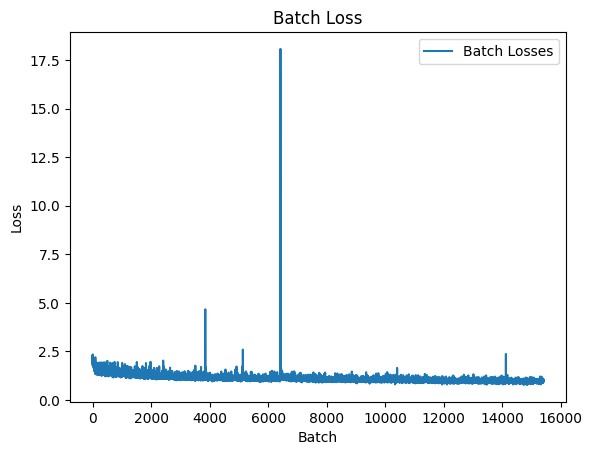

In [25]:
if train:
    df_data = pd.DataFrame({'Batch Losses': trainer.batch_losses})

    sns.lineplot(data=df_data)
    plt.xlabel('Batch')
    plt.ylabel('Loss')
    plt.title('Batch Loss')
    plt.show()
    

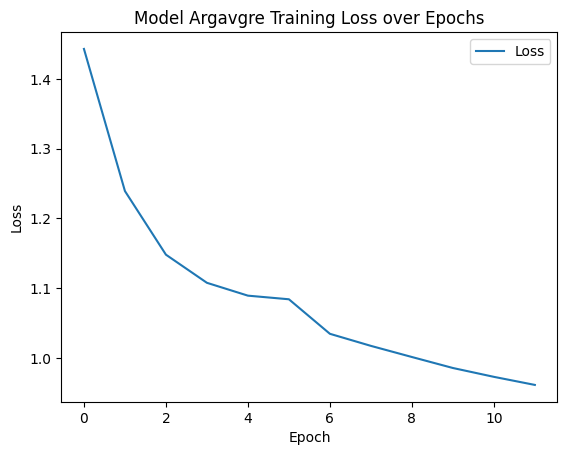

In [26]:
if train:
    df_data = pd.DataFrame({'Loss': trainer.epoch_losses})

    sns.lineplot(data=df_data)
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Model Argavgre Training Loss over Epochs')
    plt.show()

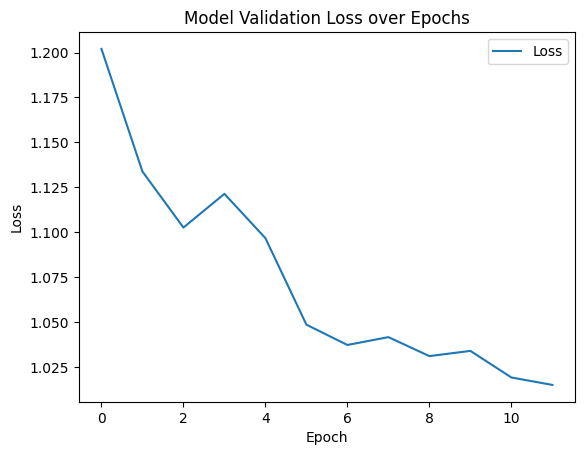

In [27]:
if train:
    df_data = pd.DataFrame({'Loss': trainer.validation_losses})

    sns.lineplot(data=df_data)
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Model Validation Loss over Epochs')
    plt.show()

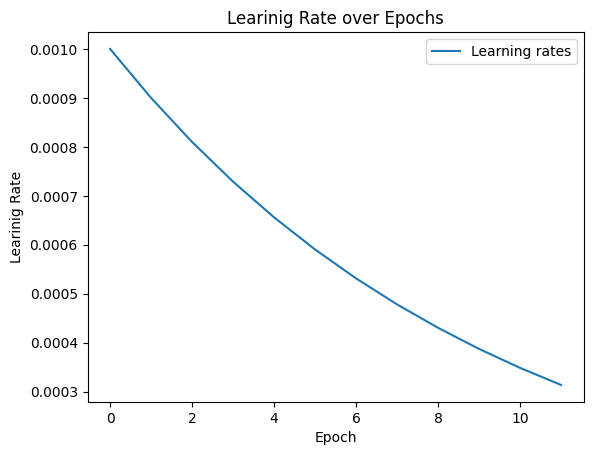

In [28]:
if train:
    df_data = pd.DataFrame({'Learning rates': trainer.learning_rates})

    sns.lineplot(data=df_data)
    plt.xlabel('Epoch')
    plt.ylabel('Learinig Rate')
    plt.title('Learinig Rate over Epochs')
    plt.show()

# Find Optimal Threshold

In [29]:
class DiceThresholdTester:
    
    def __init__(self, model: nn.Module, data_loader: torch.utils.data.DataLoader):
        self.model = model
        self.data_loader = data_loader
        self.cumulative_mask_pred = []
        self.cumulative_mask_true = []
        
    def precalculate_prediction(self) -> None:
        sigmoid = nn.Sigmoid()
        
        for images, mask_true in self.data_loader:
            if torch.cuda.is_available():
                images = images.cuda()

            mask_pred = sigmoid(model.forward(images))

            self.cumulative_mask_pred.append(mask_pred.cpu().detach().numpy())
            self.cumulative_mask_true.append(mask_true.cpu().detach().numpy())
            
        self.cumulative_mask_pred = np.concatenate(self.cumulative_mask_pred, axis=0)
        self.cumulative_mask_true = np.concatenate(self.cumulative_mask_true, axis=0)

        self.cumulative_mask_pred = torch.flatten(torch.from_numpy(self.cumulative_mask_pred))
        self.cumulative_mask_true = torch.flatten(torch.from_numpy(self.cumulative_mask_true))
    
    def test_threshold(self, threshold: float) -> float:
        _dice = Dice(use_sigmoid=False)
        after_threshold = np.zeros(self.cumulative_mask_pred.shape)
        after_threshold[self.cumulative_mask_pred[:] > threshold] = 1
        after_threshold[self.cumulative_mask_pred[:] < threshold] = 0
        after_threshold = torch.flatten(torch.from_numpy(after_threshold))
        return _dice(self.cumulative_mask_true, after_threshold).item()

In [30]:
dice_threshold_tester = DiceThresholdTester(model, data_loader_validation)
dice_threshold_tester.precalculate_prediction()

In [31]:
thresholds_to_test = [round(x * 0.01, 2) for x in range(101)]

optim_threshold = 0.975
best_dice_score = -1

thresholds = []
dice_scores = []

for t in thresholds_to_test:
    dice_score = dice_threshold_tester.test_threshold(t)
    if dice_score > best_dice_score:
        best_dice_score = dice_score
        optim_threshold = t
    
    thresholds.append(t)
    dice_scores.append(dice_score)
    
print(f'Best Threshold: {optim_threshold} with dice: {best_dice_score}')
df_threshold_data = pd.DataFrame({'Threshold': thresholds, 'Dice Score': dice_scores})

Best Threshold: 0.98 with dice: 0.5298580454726068


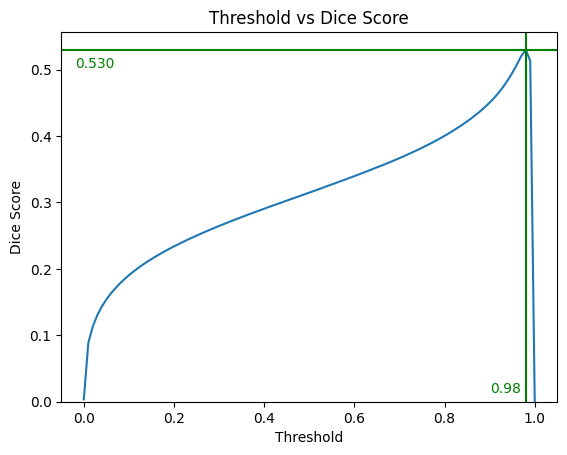

In [32]:
sns.lineplot(data=df_threshold_data, x='Threshold', y='Dice Score')
plt.axhline(y=best_dice_score, color='green')
plt.axvline(x=optim_threshold, color='green')
plt.text(-0.02, best_dice_score * 0.96, f'{best_dice_score:.3f}', va='center', ha='left', color='green')
plt.text(optim_threshold - 0.01, 0.02, f'{optim_threshold}', va='center', ha='right', color='green')
plt.ylim(bottom=0)
plt.title('Threshold vs Dice Score')
plt.show()

# Preview Models Predictions on Validation

Saved plot: plot_output CBAMUnet BCEDice/batch_1_img_1.png


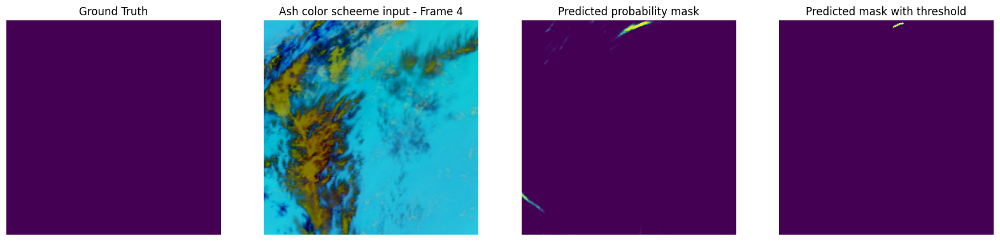

Saved plot: plot_output CBAMUnet BCEDice/batch_1_img_2.png


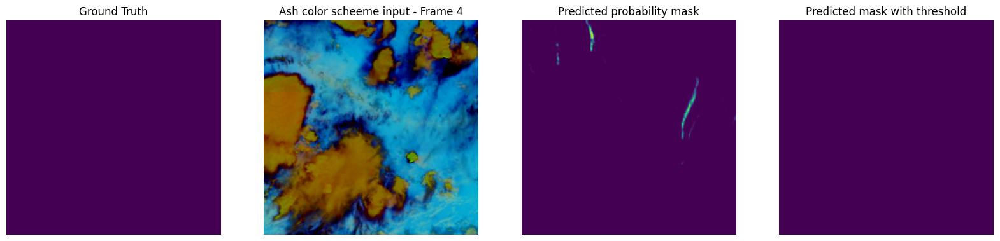

Saved plot: plot_output CBAMUnet BCEDice/batch_1_img_3.png


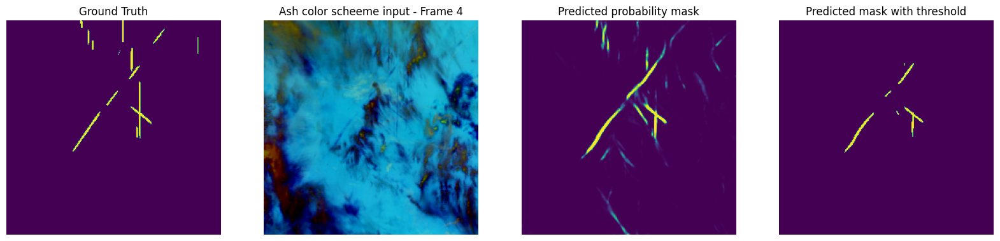

Saved plot: plot_output CBAMUnet BCEDice/batch_1_img_4.png


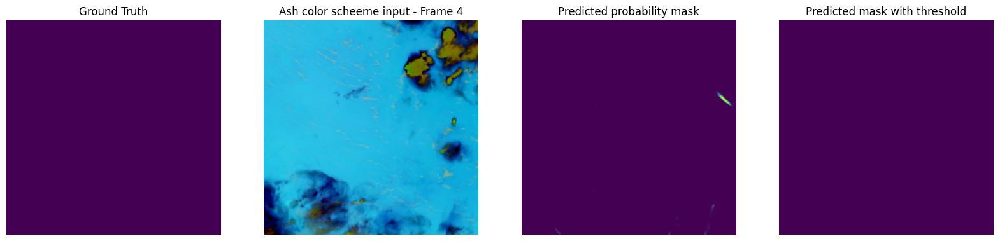

Saved plot: plot_output CBAMUnet BCEDice/batch_1_img_5.png


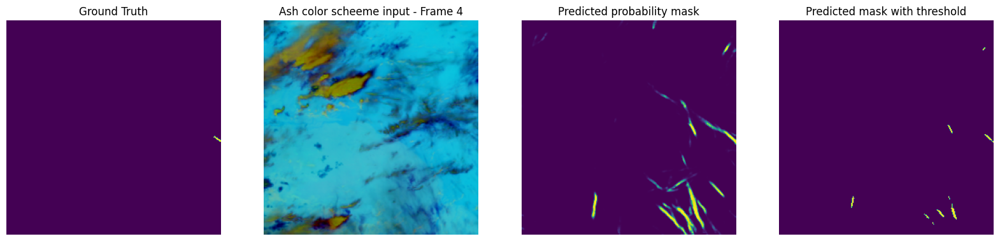

Saved plot: plot_output CBAMUnet BCEDice/batch_1_img_6.png


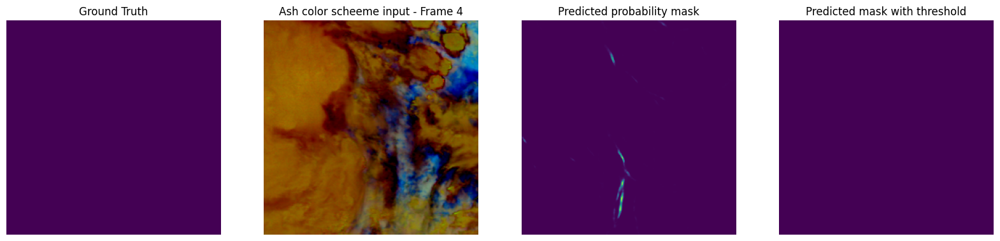

Saved plot: plot_output CBAMUnet BCEDice/batch_1_img_7.png


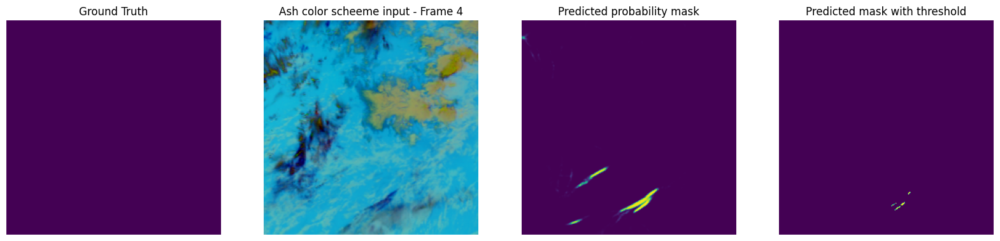

Saved plot: plot_output CBAMUnet BCEDice/batch_1_img_8.png


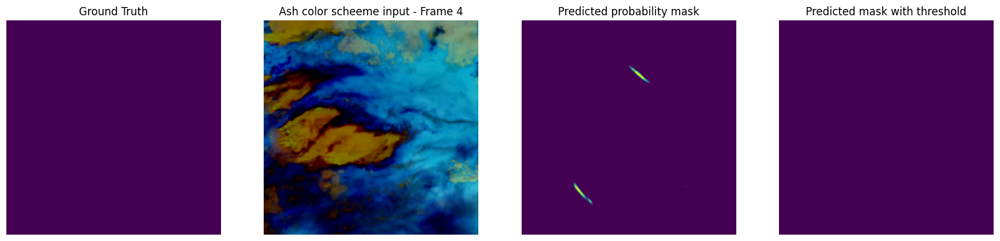

Saved plot: plot_output CBAMUnet BCEDice/batch_1_img_9.png


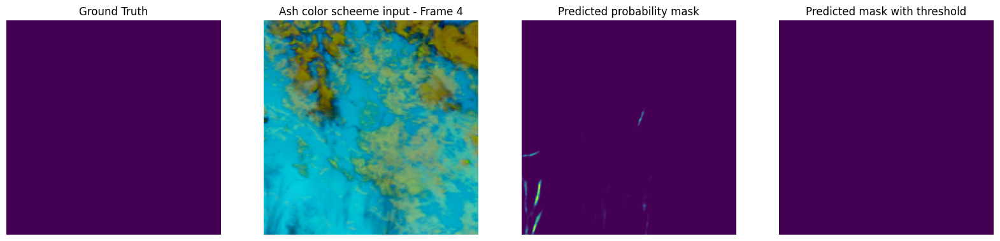

Saved plot: plot_output CBAMUnet BCEDice/batch_1_img_10.png


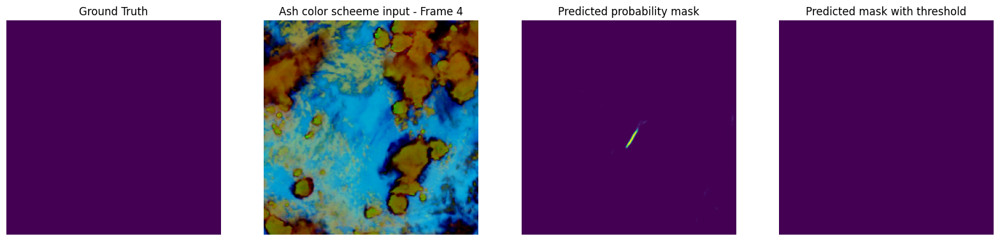

Saved plot: plot_output CBAMUnet BCEDice/batch_1_img_11.png


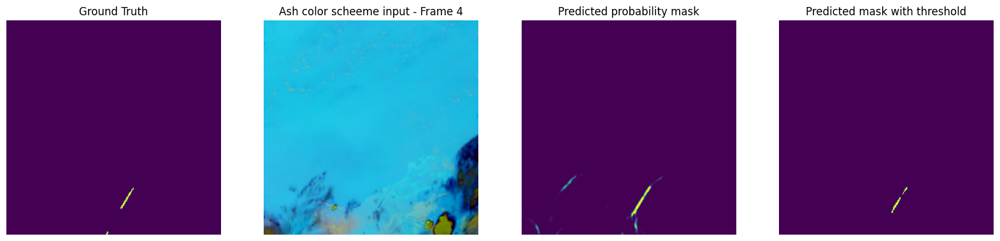

Saved plot: plot_output CBAMUnet BCEDice/batch_1_img_12.png


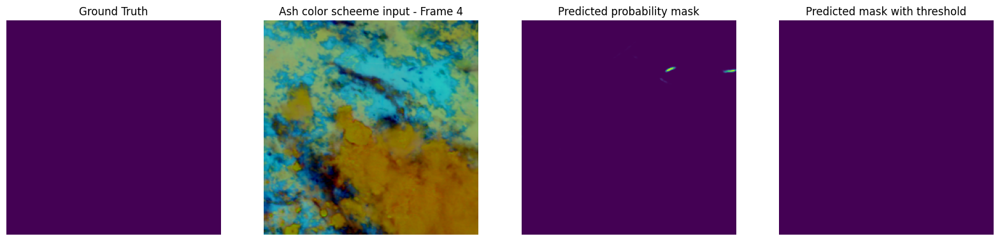

Saved plot: plot_output CBAMUnet BCEDice/batch_1_img_13.png


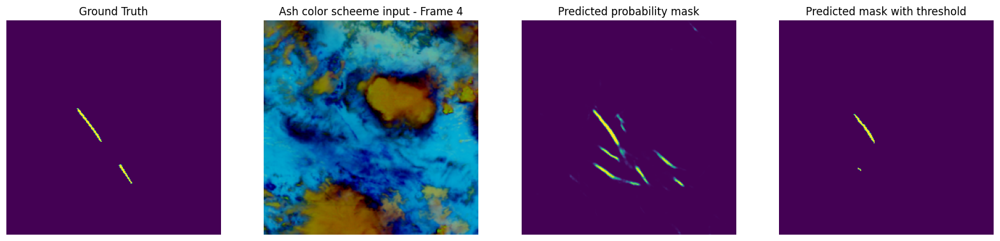

Saved plot: plot_output CBAMUnet BCEDice/batch_1_img_14.png


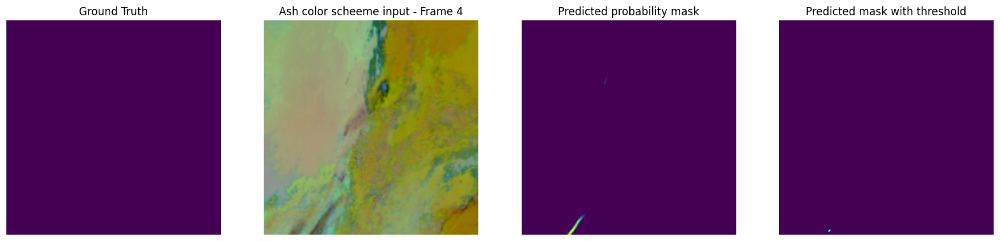

Saved plot: plot_output CBAMUnet BCEDice/batch_1_img_15.png


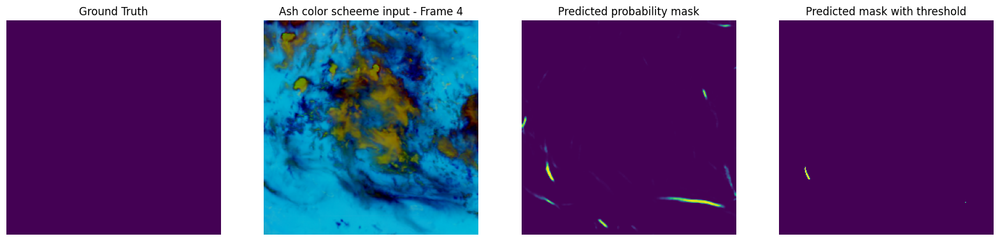

Saved plot: plot_output CBAMUnet BCEDice/batch_1_img_16.png


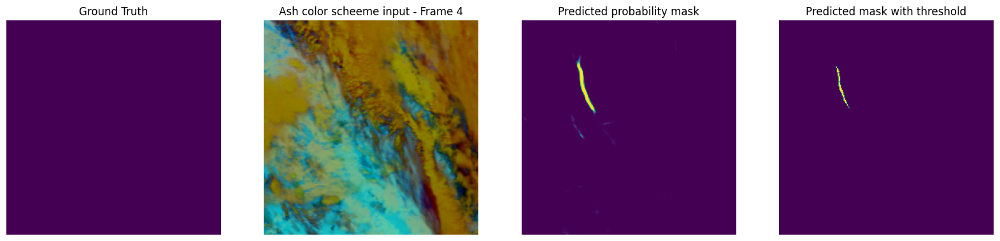

Saved plot: plot_output CBAMUnet BCEDice/batch_2_img_1.png


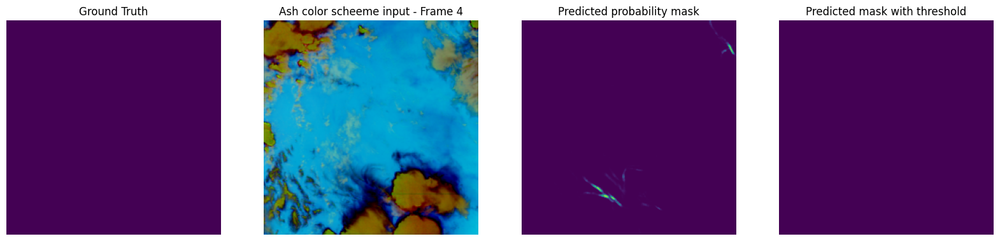

Saved plot: plot_output CBAMUnet BCEDice/batch_2_img_2.png


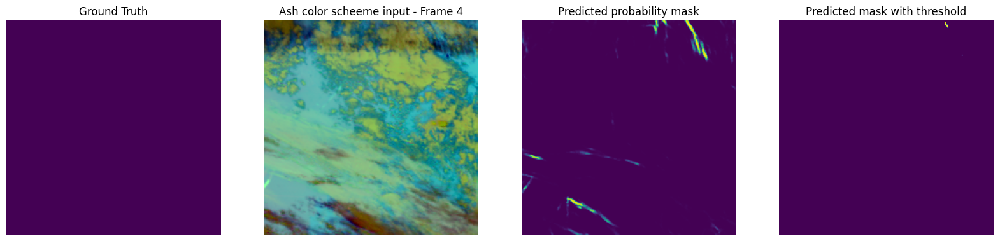

Saved plot: plot_output CBAMUnet BCEDice/batch_2_img_3.png


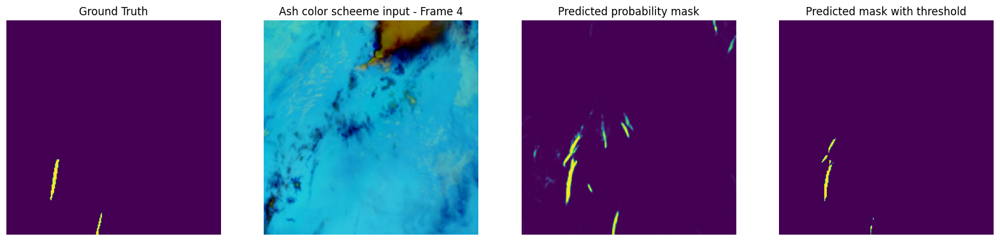

Saved plot: plot_output CBAMUnet BCEDice/batch_2_img_4.png


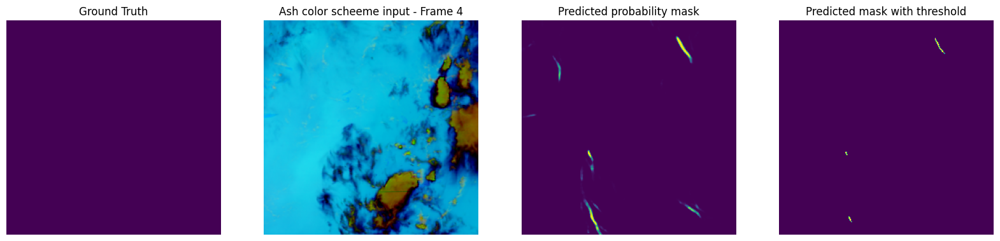

Saved plot: plot_output CBAMUnet BCEDice/batch_2_img_5.png


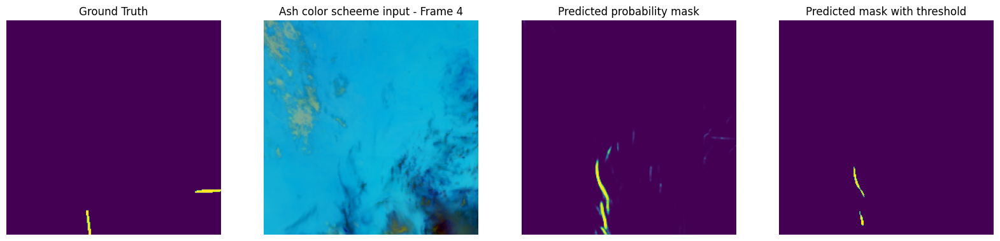

Saved plot: plot_output CBAMUnet BCEDice/batch_2_img_6.png


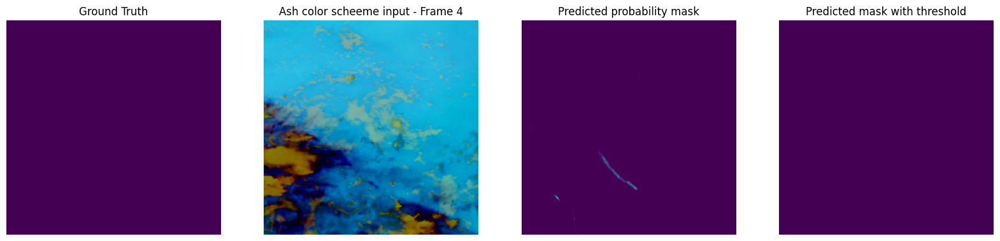

Saved plot: plot_output CBAMUnet BCEDice/batch_2_img_7.png


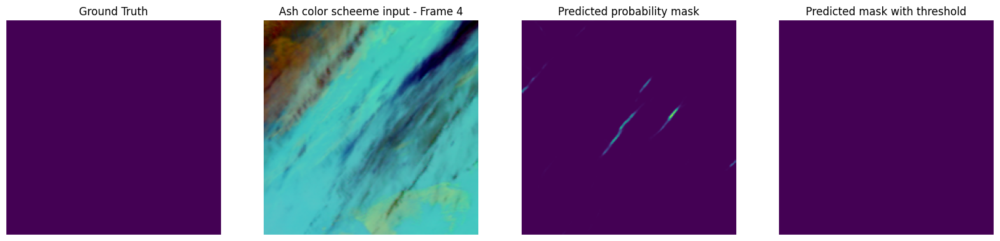

Saved plot: plot_output CBAMUnet BCEDice/batch_2_img_8.png


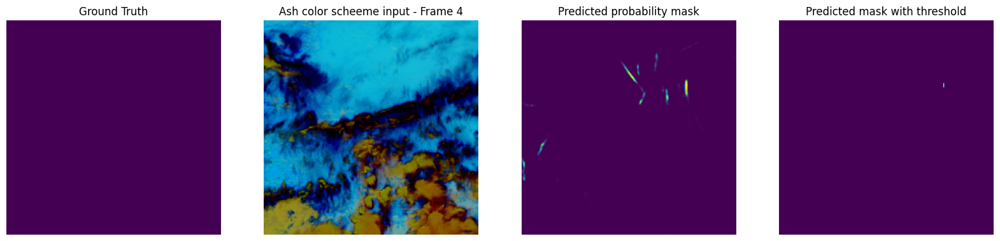

Saved plot: plot_output CBAMUnet BCEDice/batch_2_img_9.png


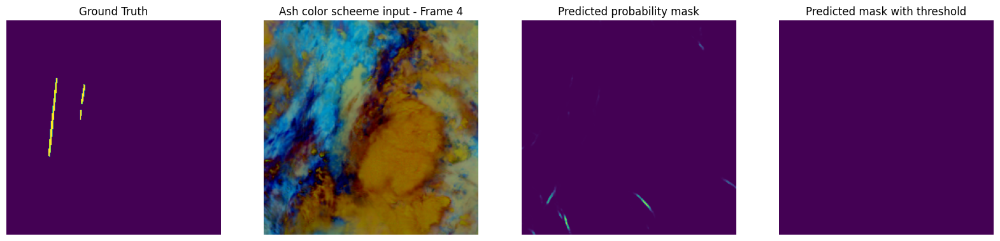

Saved plot: plot_output CBAMUnet BCEDice/batch_2_img_10.png


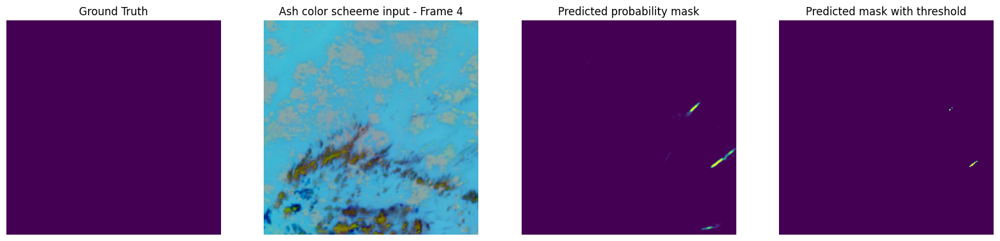

Saved plot: plot_output CBAMUnet BCEDice/batch_2_img_11.png


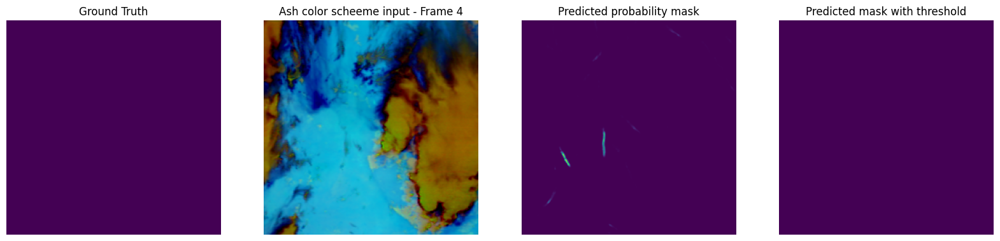

Saved plot: plot_output CBAMUnet BCEDice/batch_2_img_12.png


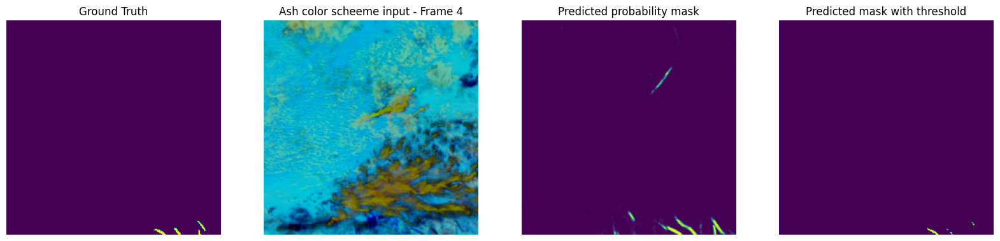

Saved plot: plot_output CBAMUnet BCEDice/batch_2_img_13.png


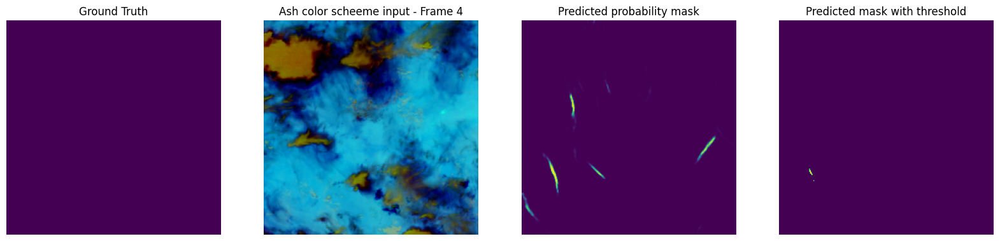

Saved plot: plot_output CBAMUnet BCEDice/batch_2_img_14.png


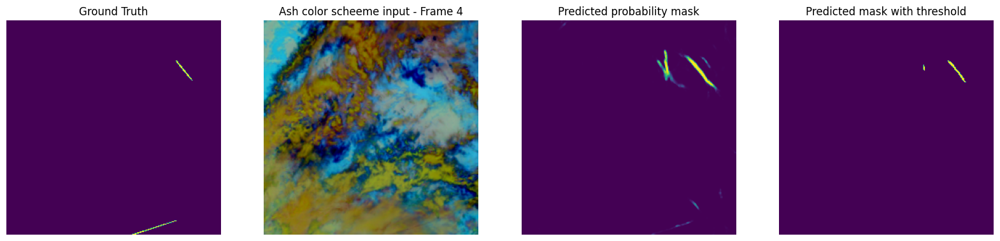

Saved plot: plot_output CBAMUnet BCEDice/batch_2_img_15.png


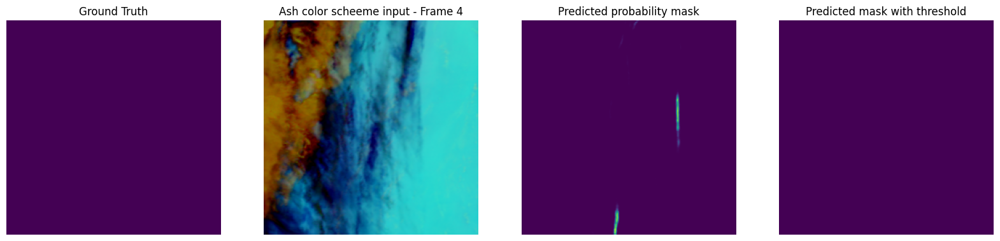

Saved plot: plot_output CBAMUnet BCEDice/batch_2_img_16.png


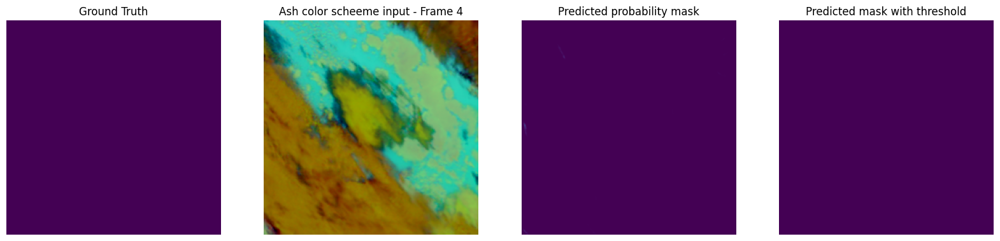

Saved plot: plot_output CBAMUnet BCEDice/batch_3_img_1.png


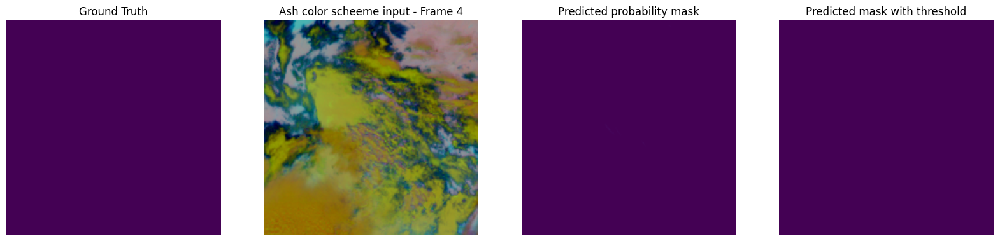

Saved plot: plot_output CBAMUnet BCEDice/batch_3_img_2.png


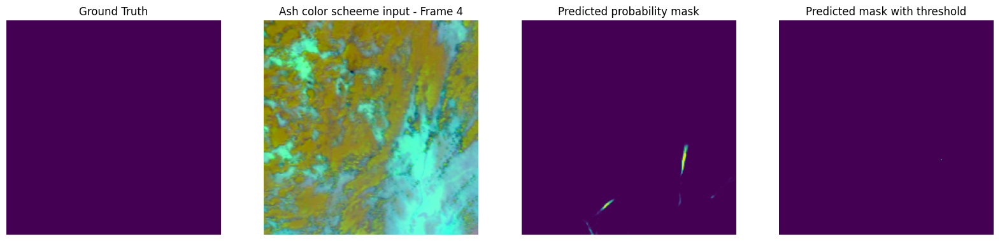

Saved plot: plot_output CBAMUnet BCEDice/batch_3_img_3.png


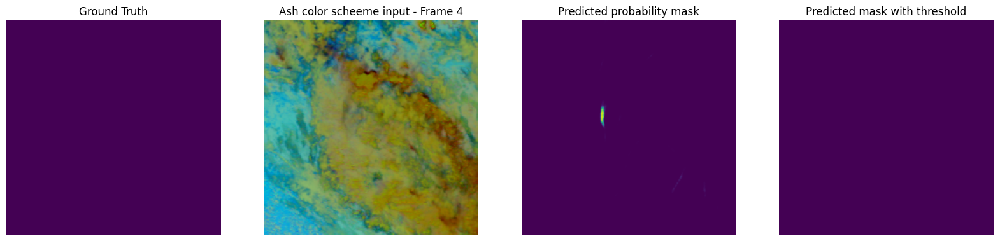

Saved plot: plot_output CBAMUnet BCEDice/batch_3_img_4.png


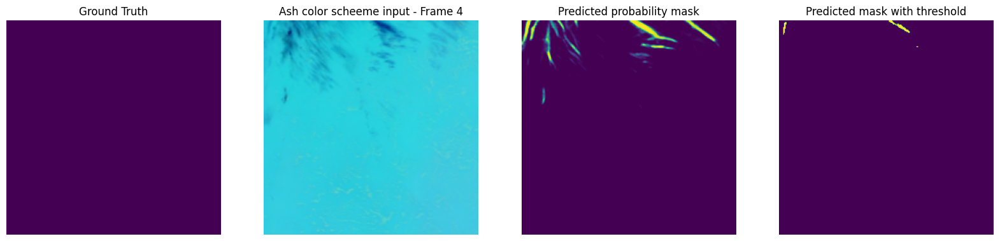

Saved plot: plot_output CBAMUnet BCEDice/batch_3_img_5.png


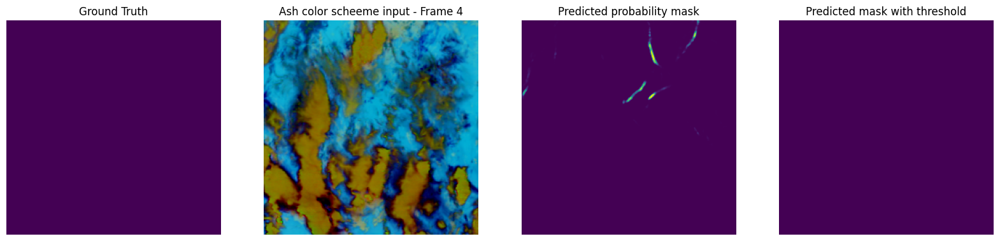

Saved plot: plot_output CBAMUnet BCEDice/batch_3_img_6.png


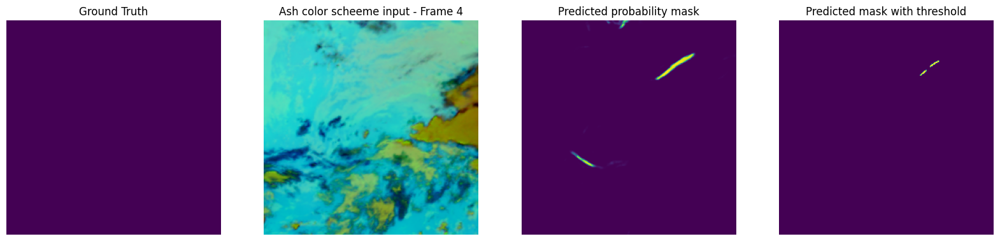

Saved plot: plot_output CBAMUnet BCEDice/batch_3_img_7.png


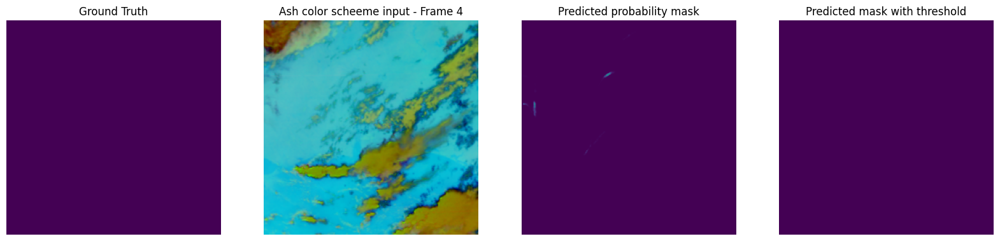

Saved plot: plot_output CBAMUnet BCEDice/batch_3_img_8.png


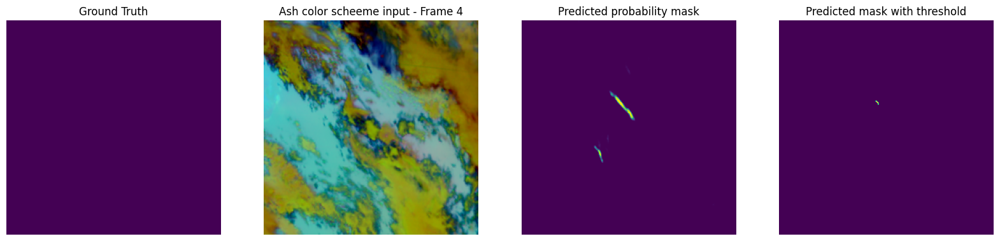

Saved plot: plot_output CBAMUnet BCEDice/batch_3_img_9.png


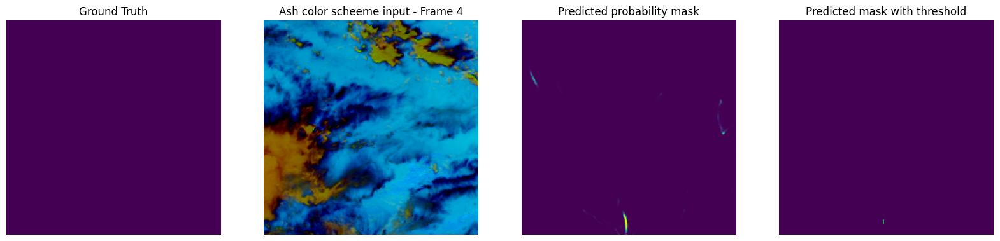

Saved plot: plot_output CBAMUnet BCEDice/batch_3_img_10.png


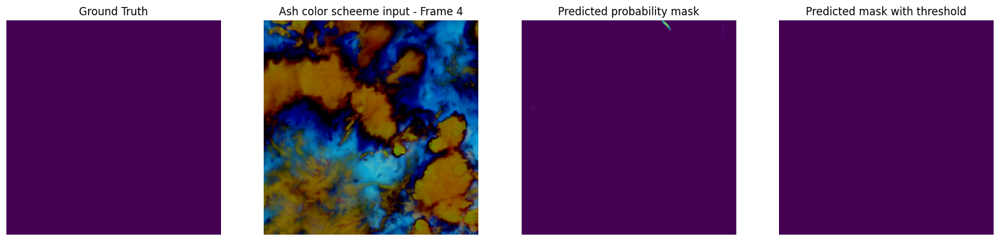

Saved plot: plot_output CBAMUnet BCEDice/batch_3_img_11.png


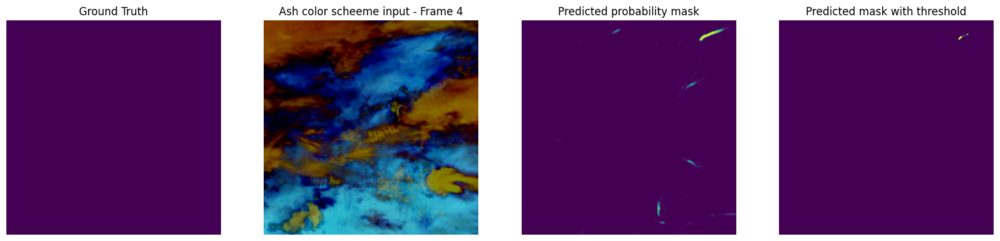

Saved plot: plot_output CBAMUnet BCEDice/batch_3_img_12.png


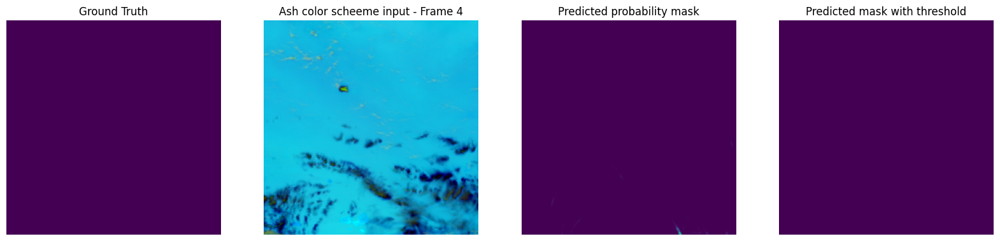

Saved plot: plot_output CBAMUnet BCEDice/batch_3_img_13.png


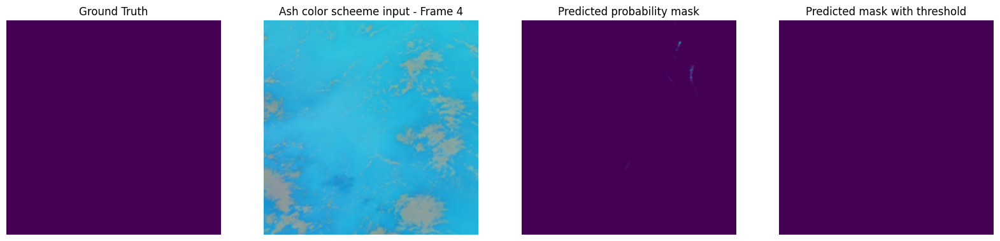

Saved plot: plot_output CBAMUnet BCEDice/batch_3_img_14.png


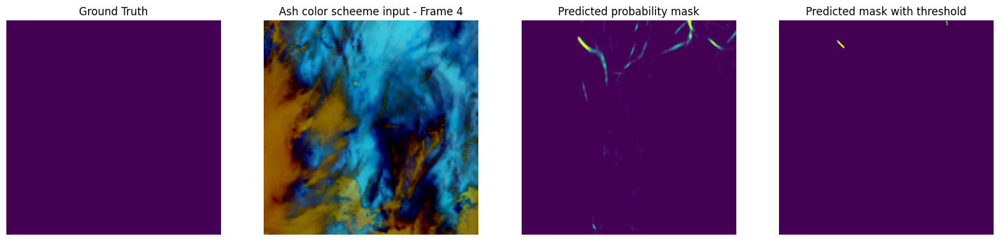

Saved plot: plot_output CBAMUnet BCEDice/batch_3_img_15.png


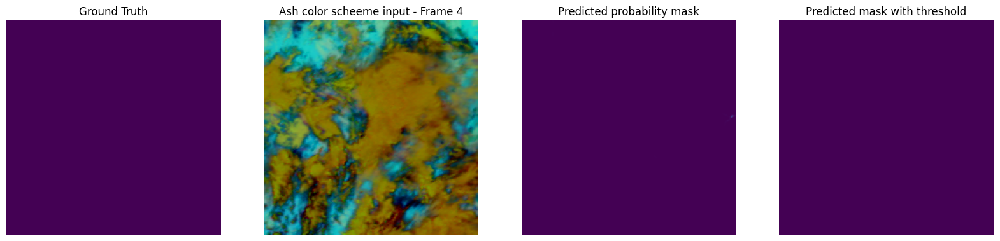

Saved plot: plot_output CBAMUnet BCEDice/batch_3_img_16.png


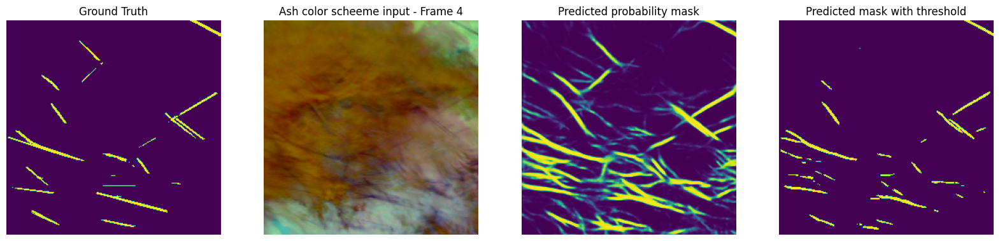

Saved plot: plot_output CBAMUnet BCEDice/batch_4_img_1.png


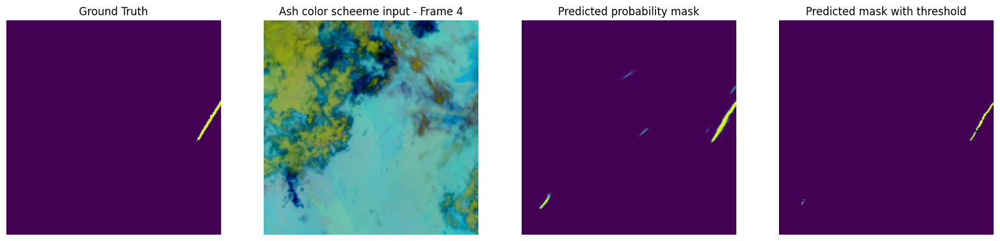

Saved plot: plot_output CBAMUnet BCEDice/batch_4_img_2.png


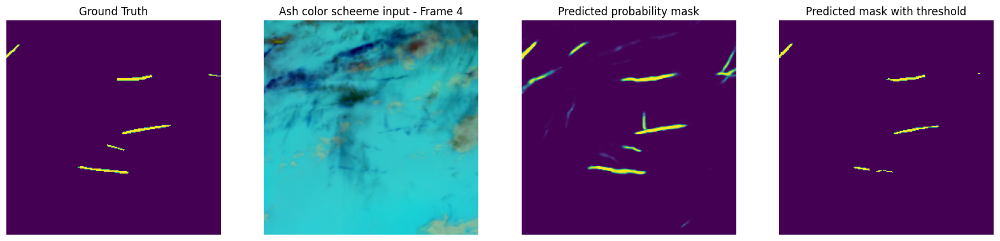

Saved plot: plot_output CBAMUnet BCEDice/batch_4_img_3.png


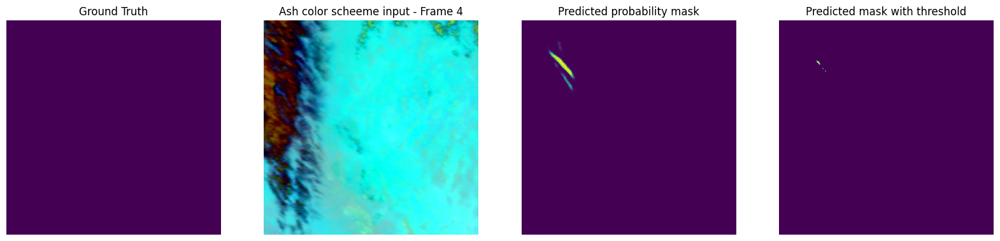

Saved plot: plot_output CBAMUnet BCEDice/batch_4_img_4.png


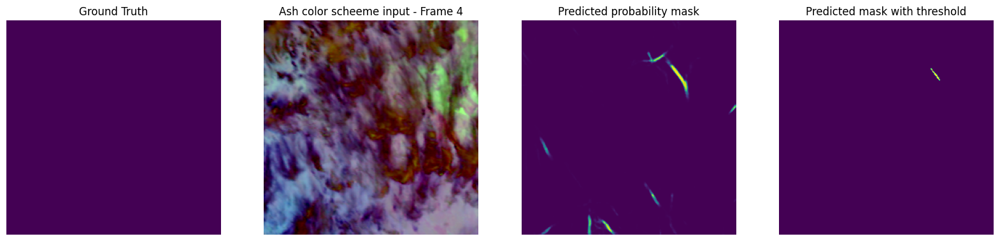

Saved plot: plot_output CBAMUnet BCEDice/batch_4_img_5.png


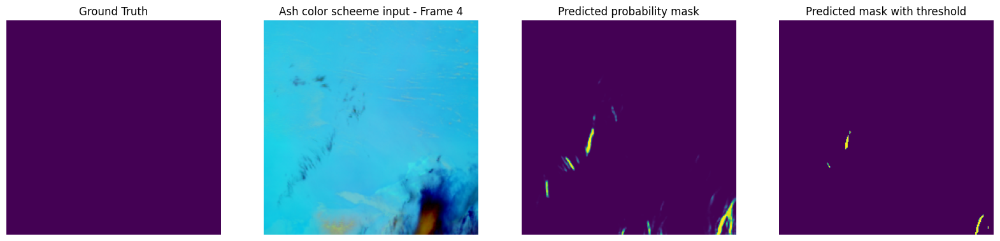

Saved plot: plot_output CBAMUnet BCEDice/batch_4_img_6.png


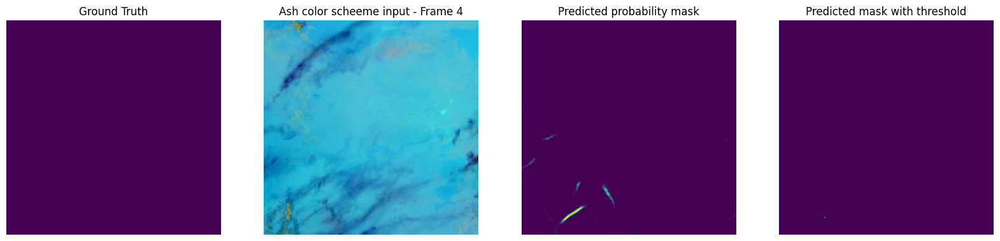

Saved plot: plot_output CBAMUnet BCEDice/batch_4_img_7.png


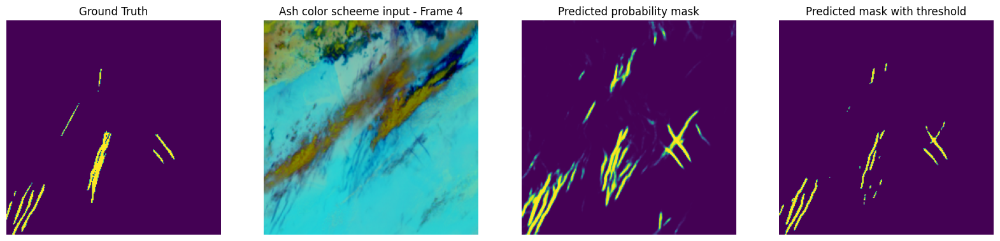

Saved plot: plot_output CBAMUnet BCEDice/batch_4_img_8.png


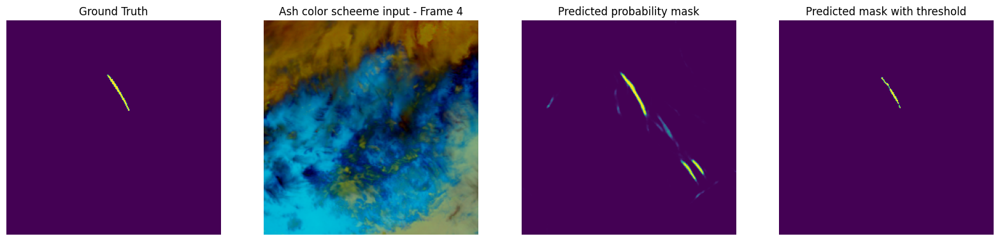

Saved plot: plot_output CBAMUnet BCEDice/batch_4_img_9.png


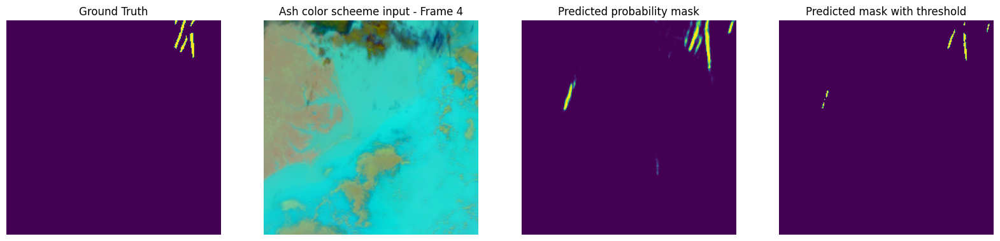

Saved plot: plot_output CBAMUnet BCEDice/batch_4_img_10.png


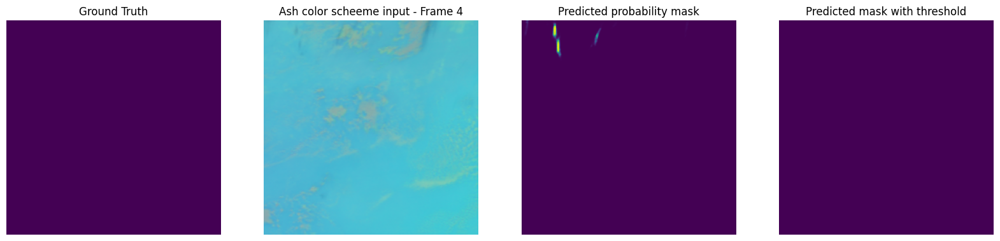

Saved plot: plot_output CBAMUnet BCEDice/batch_4_img_11.png


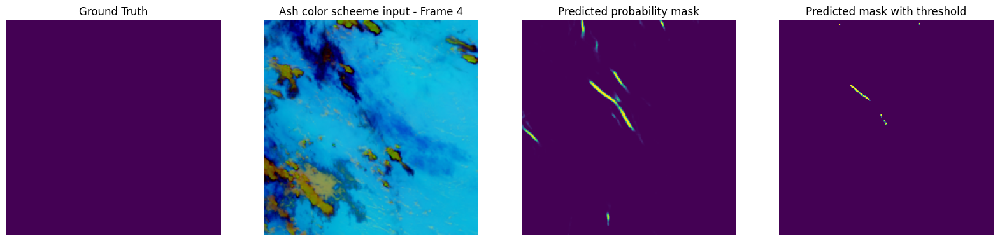

Saved plot: plot_output CBAMUnet BCEDice/batch_4_img_12.png


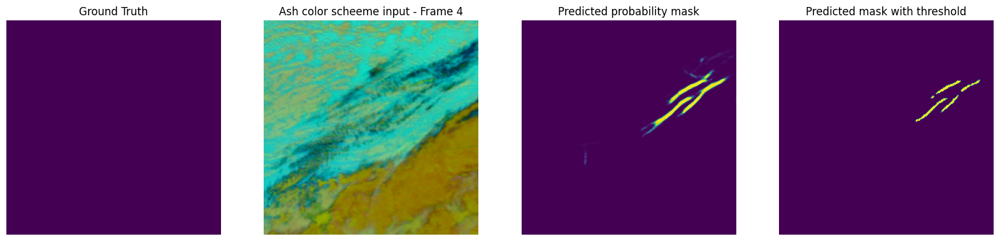

Saved plot: plot_output CBAMUnet BCEDice/batch_4_img_13.png


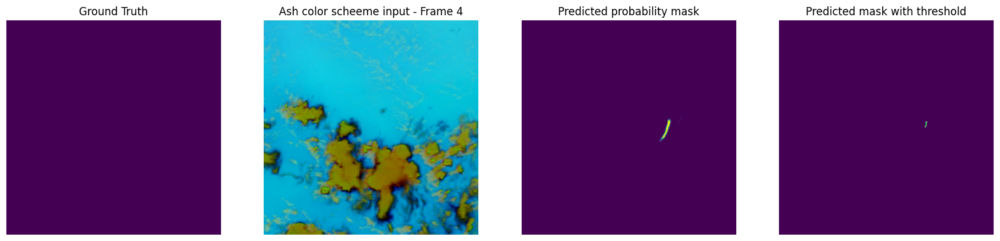

Saved plot: plot_output CBAMUnet BCEDice/batch_4_img_14.png


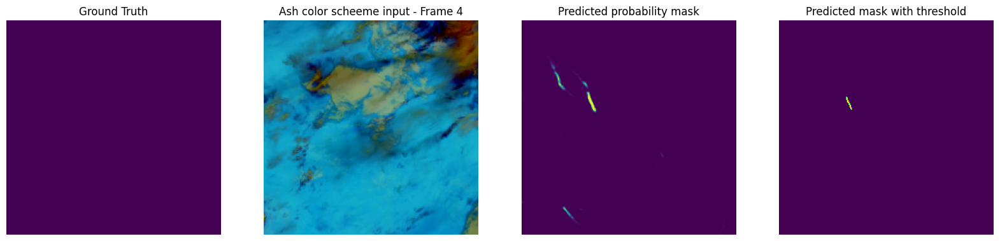

Saved plot: plot_output CBAMUnet BCEDice/batch_4_img_15.png


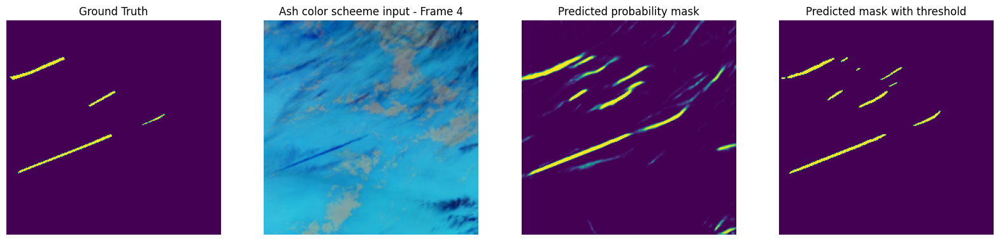

Saved plot: plot_output CBAMUnet BCEDice/batch_4_img_16.png


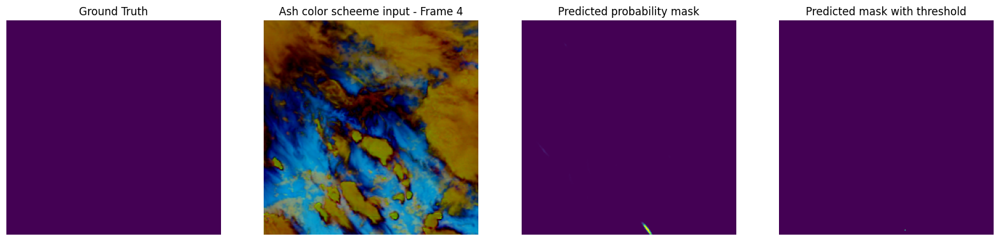

In [33]:
def sigmoid(x):
    return 1 / (1 + np.exp(-x))

batches_to_show = 4
model.eval()

for i, data in enumerate(data_loader_validation):
    images, mask = data
    
    # Predict mask for this instance
    if torch.cuda.is_available():
        images = images.cuda()
    predicated_mask = sigmoid(model.forward(images[:, :, :, :]).cpu().detach().numpy())
    
    # Apply threshold
    predicated_mask_with_threshold = np.zeros((images.shape[0], 256, 256))
    predicated_mask_with_threshold[predicated_mask[:, 0, :, :] < optim_threshold] = 0
    predicated_mask_with_threshold[predicated_mask[:, 0, :, :] > optim_threshold] = 1
    
    images = images.cpu()
        
    for img_num in range(0, images.shape[0]):
        fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(20,10))
        axes = axes.flatten()
        
        # Show groud trought 
        axes[0].imshow(mask[img_num, 0, :, :])
        axes[0].axis('off')
        axes[0].set_title('Ground Truth')
        
        # Show ash color scheme input image
        axes[1].imshow( np.concatenate(
            (
            np.expand_dims(images[img_num, 4, :, :], axis=2),
            np.expand_dims(images[img_num, 12, :, :], axis=2),
            np.expand_dims(images[img_num, 20, :, :], axis=2)
        ), axis=2))
        axes[1].axis('off')
        axes[1].set_title('Ash color scheeme input - Frame 4')

        # Show predicted mask
        axes[2].imshow(predicated_mask[img_num, 0, :, :], vmin=0, vmax=1)
        axes[2].axis('off')
        axes[2].set_title('Predicted probability mask')

        # Show predicted mask after threshold
        axes[3].imshow(predicated_mask_with_threshold[img_num, :, :])
        axes[3].axis('off')
        axes[3].set_title('Predicted mask with threshold')

        output_dir = "plot_output CBAMUnet BCEDice"
        os.makedirs(output_dir, exist_ok=True)

        # Save the plot
        plot_filename = os.path.join(output_dir, f"batch_{i+1}_img_{img_num+1}.png")
        plt.savefig(plot_filename)
        print(f"Saved plot: {plot_filename}")   
        
        plt.show()
    
    if i + 1 >= batches_to_show:
        break